In [202]:
import pandas as pd
import requests
import json
from sklearn.linear_model import LinearRegression
import seaborn as sns
import matplotlib.pyplot as plt


In [203]:

archivo_csv = "tabla_sin_caribe_ok.csv"

# Cargar el archivo CSV en un DataFrame
tabla_sin_caribe = pd.read_csv(archivo_csv)




In [204]:
tabla_sin_caribe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 759 entries, 0 to 758
Data columns (total 50 columns):
 #   Column                                                                                              Non-Null Count  Dtype  
---  ------                                                                                              --------------  -----  
 0   País                                                                                                759 non-null    object 
 1   Año                                                                                                 759 non-null    int64  
 2   Birth rate, crude (per 1,000 people)                                                                736 non-null    float64
 3   CO2 emissions (kg per PPP $ of GDP)                                                                 673 non-null    float64
 4   Capital health expenditure (% of GDP)                                                               431 non-null    

In [205]:
tabla_sin_caribe.head(40)

,País,Año,"Birth rate, crude (per 1,000 people)",CO2 emissions (kg per PPP $ of GDP),Capital health expenditure (% of GDP),"Compulsory education, duration (years)",Control of Corruption: Estimate,"Current health expenditure per capita, PPP (current international $)","Death rate, crude (per 1,000 people)",Domestic general government health expenditure (% of GDP),...,"Population, total",Poverty gap at $6.85 a day (2017 PPP) (%),Pregnant women receiving prenatal care (%),Prevalence of overweight (% of adults),"Prevalence of overweight, weight for height (% of children under 5)",Prevalence of undernourishment (% of population),Rural population (% of total population),"Unemployment, total (% of total labor force) (modeled ILO estimate)",Urban population,Urban population (% of total population)
0,Argentina,1990,21.989,0.427859,NaN,NaN,NaN,NaN,7.743,NaN,...,32637657.0,NaN,NaN,48.7,NaN,NaN,13.016,NaN,28389540.0,86.984
1,Argentina,1991,21.844,0.400371,NaN,NaN,NaN,NaN,7.536,NaN,...,33105763.0,4.5,NaN,49.3,NaN,NaN,12.672,5.440,28910601.0,87.328
2,Argentina,1992,21.683,0.369563,NaN,NaN,NaN,NaN,7.595,NaN,...,33568285.0,5.0,NaN,49.9,NaN,NaN,12.458,6.360,29386348.0,87.542
3,Argentina,1993,21.570,0.340845,NaN,NaN,NaN,NaN,7.631,NaN,...,34027240.0,5.5,95.0,50.5,NaN,NaN,12.248,10.100,29859584.0,87.752
4,Argentina,1994,21.419,0.320044,NaN,NaN,NaN,NaN,7.403,NaN,...,34488696.0,5.7,NaN,51.1,11.1,NaN,12.040,11.760,30336257.0,87.960
5,Argentina,1995,20.974,0.325468,NaN,NaN,NaN,NaN,7.535,NaN,...,34946110.0,8.1,NaN,51.7,NaN,NaN,11.836,18.800,30809888.0,88.164
6,Argentina,1996,20.449,0.328792,NaN,NaN,-0.101317,NaN,7.541,NaN,...,35389362.0,9.2,NaN,52.2,13.5,NaN,11.634,17.110,31272164.0,88.366
7,Argentina,1997,19.985,0.307685,NaN,NaN,NaN,NaN,7.778,NaN,...,35815971.0,8.5,NaN,52.8,NaN,NaN,11.436,14.820,31720057.0,88.564
8,Argentina,1998,19.738,0.308199,NaN,10.0,-0.203482,NaN,7.651,NaN,...,36233195.0,9.4,NaN,53.3,NaN,NaN,11.241,12.650,32160222.0,88.759
9,Argentina,1999,19.674,0.318910,NaN,10.0,NaN,NaN,7.615,NaN,...,36653031.0,9.7,NaN,53.9,NaN,NaN,11.048,14.050,32603604.0,88.952


In [206]:


# Utiliza el método duplicated para verificar duplicados
duplicados = tabla_sin_caribe.duplicated()

# Filtra las filas con duplicados (si los hay)
duplicados_df = tabla_sin_caribe[duplicados]

# Imprime el DataFrame de duplicados
print(duplicados_df)


Empty DataFrame
Columns: [País, Año, Birth rate, crude (per 1,000 people), CO2 emissions (kg per PPP $ of GDP), Capital health expenditure (% of GDP), Compulsory education, duration (years), Control of Corruption: Estimate, Current health expenditure per capita, PPP (current international $), Death rate, crude (per 1,000 people), Domestic general government health expenditure (% of GDP), Domestic general government health expenditure per capita, PPP (current international $), Domestic private health expenditure (% of current health expenditure), Educational attainment, at least completed lower secondary, population 25+, total (%) (cumulative), Fertility rate, total (births per woman), GDP growth (annual %), GDP per capita, PPP (constant 2017 international $), GDP, PPP (constant 2017 international $), Gini index, Government expenditure on education, total (% of GDP), Life expectancy at birth, female (years), Life expectancy at birth, male (years), Life expectancy at birth, total (years)

Tratamiento de Nulos. Por indicador por país

In [207]:
# Reemplazar NaN con NaN (esto es solo para asegurarnos de que todas las celdas sean NaN)
tabla_sin_caribe = tabla_sin_caribe.fillna(value=pd.NA)

# Reemplazar ceros con NaN
tabla_sin_caribe = tabla_sin_caribe.replace(0, pd.NA)


In [208]:
#Registramso porcentaje de nulos por indicador por país
import pandas as pd


# Establecer el rango de años para el cálculo del porcentaje
inicio_serie_temporal = 1990
fin_serie_temporal = 2022
num_years = fin_serie_temporal - inicio_serie_temporal + 1

# Creamos un DataFrame para almacenar la cantidad de registros no nulos para cada indicador por país
registros_no_nulos_por_pais_indicador = pd.DataFrame(index=tabla_sin_caribe['País'].unique())

# Iteramos sobre las columnas de indicadores para calcular la cantidad de registros no nulos por país
for indicador in tabla_sin_caribe.columns.difference(['País']):
    # Contamos los valores no nulos por país para el indicador actual
    registros_no_nulos = tabla_sin_caribe.groupby('País')[indicador].apply(lambda x: x.notnull().sum())
    
    # Añadimos estos datos al DataFrame
    registros_no_nulos_por_pais_indicador[indicador] = registros_no_nulos

# Calculamos el porcentaje de registros no nulos para cada indicador por país
porcentaje_no_nulos = (registros_no_nulos_por_pais_indicador / num_years) * 100

# Creamos una máscara para aquellos indicadores por país que tienen menos del 38% de nulos (más del 62% de registros no nulos)
mascara_umbral = porcentaje_no_nulos >= (100 - 38)

# Usamos la máscara para filtrar los indicadores que satisfacen el umbral
indicadores_satisfactorios = registros_no_nulos_por_pais_indicador[mascara_umbral]

# Transponemos el resultado para una mejor visualización y coherencia con el DataFrame original
indicadores_satisfactorios = indicadores_satisfactorios.transpose()

# Imprimimos el resultado
print(indicadores_satisfactorios)


                                                    Argentina  Bolivia  \
Año                                                      33.0     33.0   
Birth rate, crude (per 1,000 people)                     32.0     32.0   
CO2 emissions (kg per PPP $ of GDP)                      31.0     31.0   
Capital health expenditure (% of GDP)                     NaN      NaN   
Compulsory education, duration (years)                   25.0     25.0   
Control of Corruption: Estimate                          24.0     24.0   
Current health expenditure per capita, PPP (cur...       21.0     21.0   
Death rate, crude (per 1,000 people)                     32.0     32.0   
Domestic general government health expenditure ...       21.0     21.0   
Domestic general government health expenditure ...       21.0     21.0   
Domestic private health expenditure (% of curre...       21.0     21.0   
Educational attainment, at least completed lowe...        NaN     21.0   
Fertility rate, total (births per woma

In [209]:
#Porcentaje de nulos

# Supongamos que 'tabla_sin_caribe' es tu DataFrame y ya está cargado.

# Establecer el rango de años para el cálculo del porcentaje
inicio_serie_temporal = 1990
fin_serie_temporal = 2022
num_years = fin_serie_temporal - inicio_serie_temporal + 1

# Creamos un DataFrame para almacenar la cantidad de registros no nulos para cada indicador por país
registros_no_nulos_por_pais_indicador = pd.DataFrame(index=tabla_sin_caribe['País'].unique())

# Iteramos sobre las columnas de indicadores para calcular la cantidad de registros no nulos por país
for indicador in tabla_sin_caribe.columns.difference(['País']):
    # Contamos los valores no nulos por país para el indicador actual
    registros_no_nulos = tabla_sin_caribe.groupby('País')[indicador].apply(lambda x: x.notnull().sum())
    
    # Añadimos estos datos al DataFrame
    registros_no_nulos_por_pais_indicador[indicador] = registros_no_nulos

# Ahora calculamos el porcentaje de registros no nulos para cada indicador por país
porcentaje_no_nulos = (registros_no_nulos_por_pais_indicador / num_years) * 100

# Creamos una máscara para aquellos indicadores por país que tienen menos del 38% de nulos (más del 62% de registros no nulos)
mascara_umbral = porcentaje_no_nulos >= (100 - 38)

# Aplicamos la máscara para obtener solo los indicadores y países que cumplen con el umbral
indicadores_validos = registros_no_nulos_por_pais_indicador[mascara_umbral].stack().reset_index()
indicadores_validos.columns = ['País', 'Indicador', 'Cantidad de Registros No Nulos']

# Ahora podemos eliminar las filas donde 'Cantidad de Registros No Nulos' es NaN, lo cual indica que el porcentaje de nulos superó el 38%
indicadores_validos.dropna(subset=['Cantidad de Registros No Nulos'], inplace=True)

# Imprimimos el DataFrame resultante
print(indicadores_validos)


              País                                          Indicador  \
0        Argentina                                                Año   
1        Argentina               Birth rate, crude (per 1,000 people)   
2        Argentina                CO2 emissions (kg per PPP $ of GDP)   
3        Argentina             Compulsory education, duration (years)   
4        Argentina                    Control of Corruption: Estimate   
..             ...                                                ...   
896  Venezuela, RB             Prevalence of overweight (% of adults)   
897  Venezuela, RB           Rural population (% of total population)   
898  Venezuela, RB  Unemployment, total (% of total labor force) (...   
899  Venezuela, RB                                   Urban population   
900  Venezuela, RB           Urban population (% of total population)   

     Cantidad de Registros No Nulos  
0                              33.0  
1                              32.0  
2        

In [210]:
#Cantidad de registros (Años) no nulos
indicadores_validos.head()


,País,Indicador,Cantidad de Registros No Nulos
0,Argentina,Año,33.0
1,Argentina,"Birth rate, crude (per 1,000 people)",32.0
2,Argentina,CO2 emissions (kg per PPP $ of GDP),31.0
3,Argentina,"Compulsory education, duration (years)",25.0
4,Argentina,Control of Corruption: Estimate,24.0


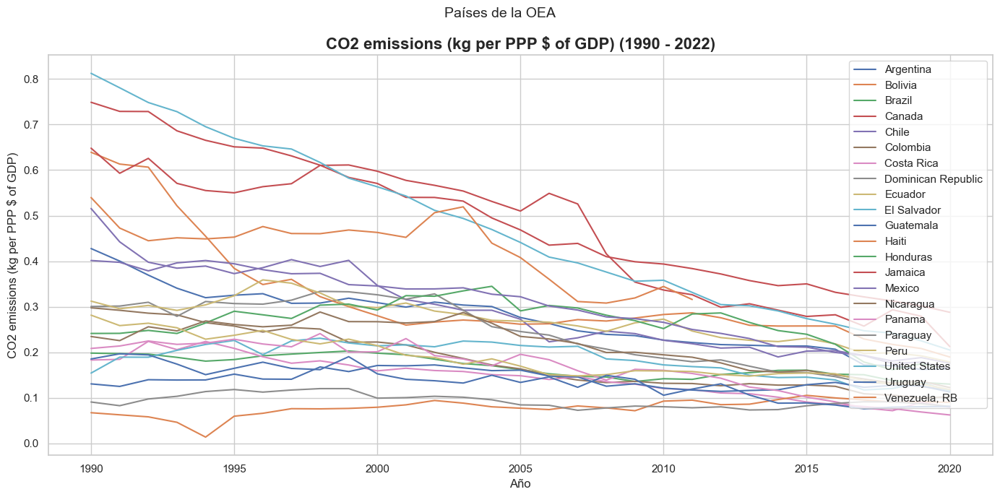

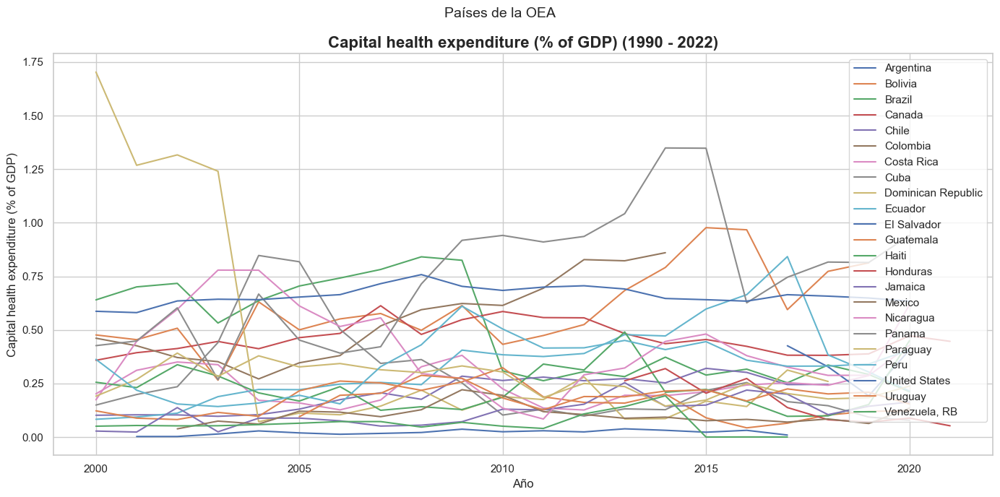

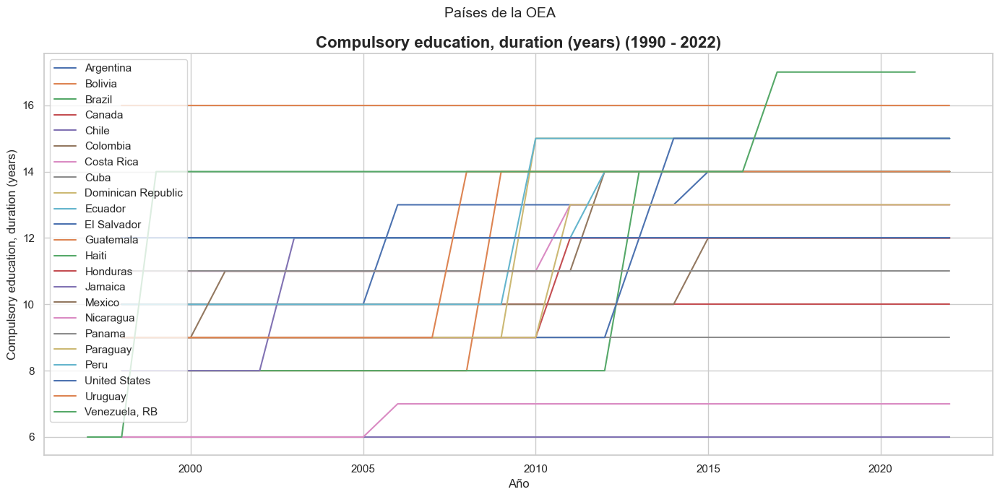

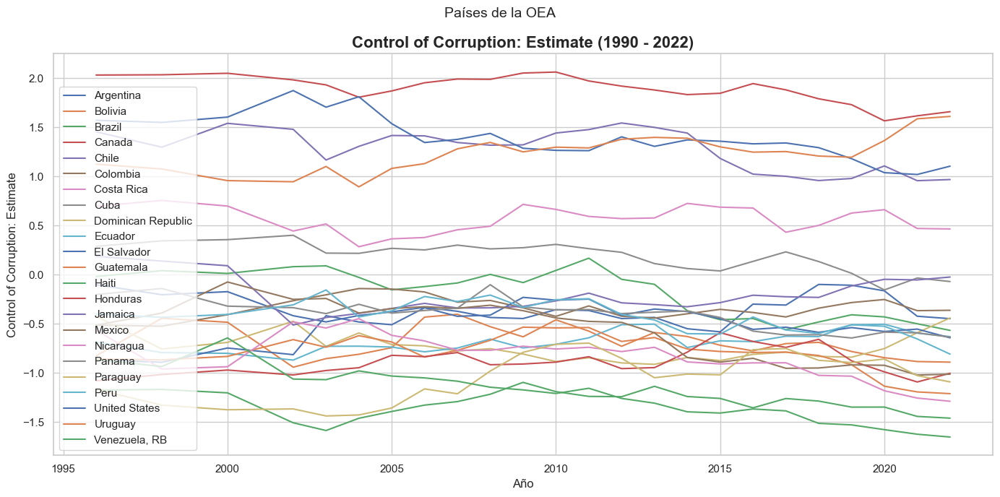

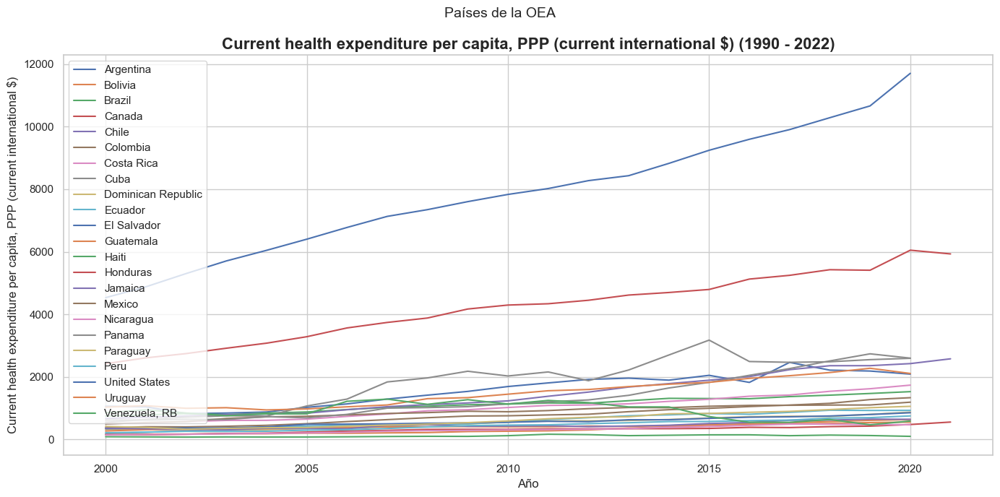

...

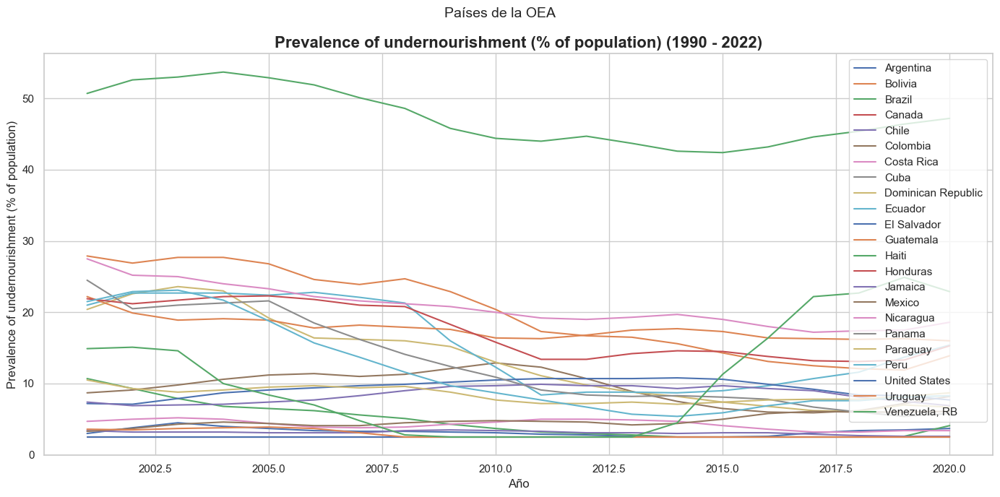

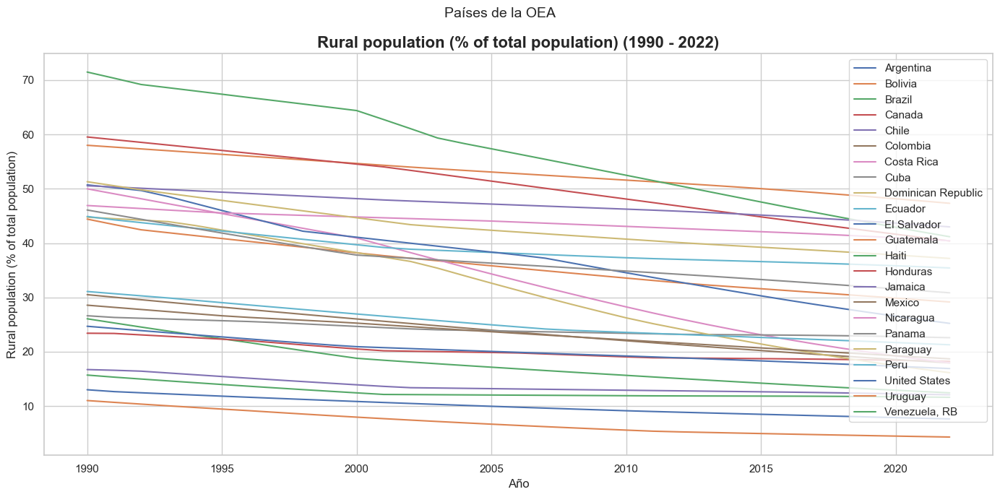

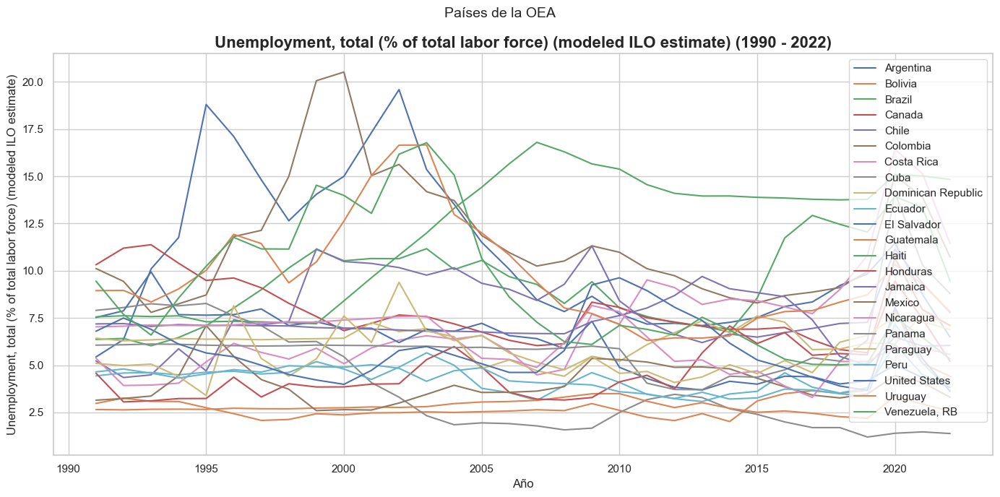

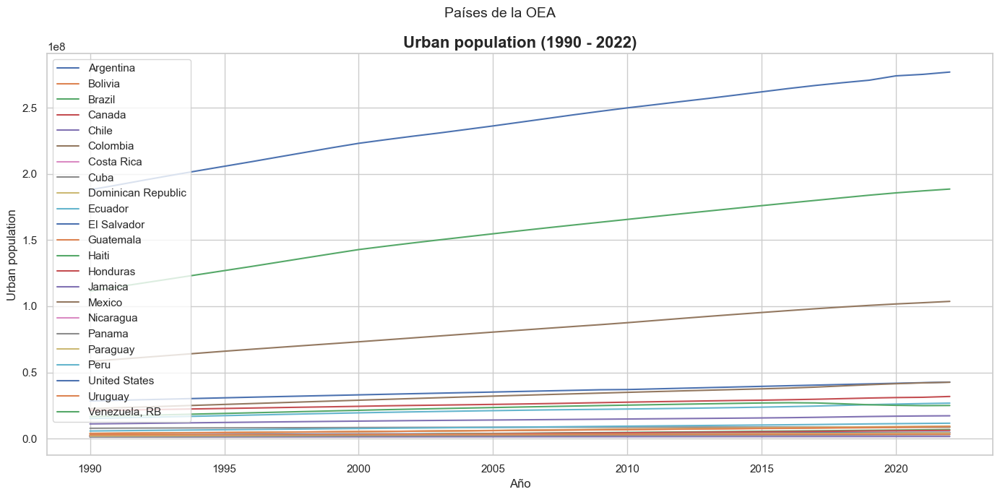

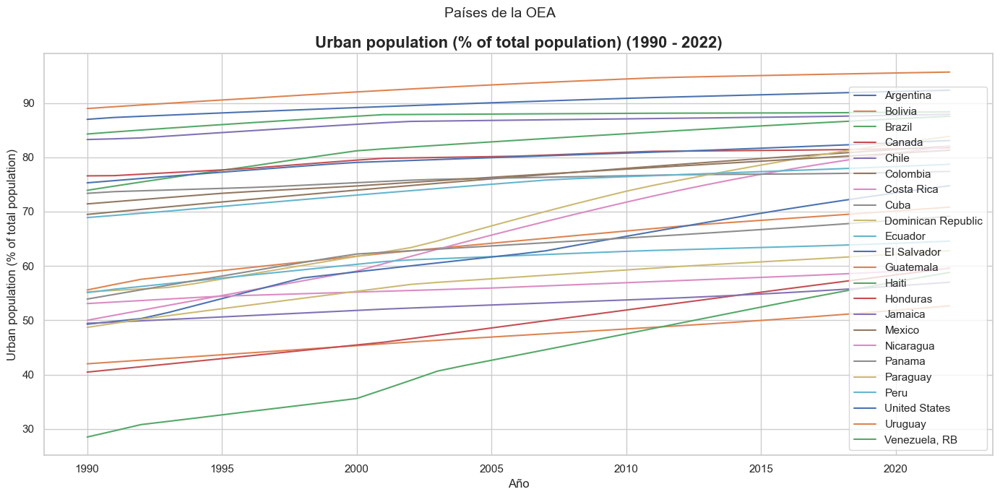

In [211]:
#Analizamos tendencias de indicadores validos, que pasaron el umbral de 38% de nulos por serie temporal
import matplotlib.pyplot as plt

# Define el tamaño de fuente escalonado
tamanos_de_fuente = [16, 14, 12]

# Obtén la lista de nombres de indicadores (columnas) en tu DataFrame, comenzando desde la posición 3
indicadores = tabla_sin_caribe.columns[3:]

# Recorre cada indicador y crea un gráfico de series temporales
for indicador in indicadores:
    plt.figure(figsize=(14, 7))  # Ajusta el tamaño de la figura si es necesario
    
    # Para cada país, filtramos los datos del indicador actual y graficamos
    for pais in tabla_sin_caribe['País'].unique():
        # Filtra los datos para el país actual y el indicador actual
        datos_pais = tabla_sin_caribe[(tabla_sin_caribe['País'] == pais)]
        
        # Asegúrate de tener solo datos no nulos para el indicador actual
        datos_pais = datos_pais[datos_pais[indicador].notnull()]
        
        # Si no hay datos después de filtrar los nulos, continúa con el siguiente país
        if datos_pais.empty:
            continue
        
        # Suponiendo que la columna 'Año' existe y contiene los años correspondientes
        plt.plot(datos_pais['Año'], datos_pais[indicador], label=pais)
    
    # Si ningún país tiene datos no nulos para el indicador, no queremos mostrar una gráfica vacía
    if plt.gca().has_data():
        # Ajustes visuales del gráfico
        plt.title(f'{indicador} (1990 - 2022)', fontsize=tamanos_de_fuente[0], weight='bold')
        plt.suptitle('Países de la OEA', fontsize=tamanos_de_fuente[1])
        plt.xlabel('Año', fontsize=tamanos_de_fuente[2])
        plt.ylabel(indicador, fontsize=tamanos_de_fuente[2])
        plt.legend()
        plt.grid(True)
        plt.tight_layout()  # Ajusta automáticamente los parámetros de la subtrama
        plt.show()


Imputacion Nulos. Modelo regresión Lineal

In [212]:
from sklearn.linear_model import LinearRegression

# Asumiendo que 'tabla_sin_caribe' es tu DataFrame con los datos originales
# y 'indicadores_validos' es un DataFrame con los indicadores con menos del 38% de nulos por país

# Crea un nuevo DataFrame para almacenar los valores imputados
tabla_con_imputaciones = tabla_sin_caribe.copy()

# Realiza la imputación utilizando regresión lineal solo para los indicadores válidos
for _, row in indicadores_validos.iterrows():
    pais = row['País']
    indicador = row['Indicador']
    
    # Filtramos los datos para el país e indicador actuales que están en la lista de válidos
    df_pais = tabla_sin_caribe[tabla_sin_caribe['País'] == pais]
    serie_temporal = df_pais[indicador].dropna()
    años_con_datos = df_pais.loc[serie_temporal.index, 'Año']
    
    # Verificamos que haya suficientes datos para crear el modelo de regresión
    if len(serie_temporal) > 1:
        # Preparamos los datos para el modelo de regresión
        X_train = años_con_datos.values.reshape(-1, 1)
        y_train = serie_temporal.values
        
        # Creamos y entrenamos el modelo de regresión lineal
        model = LinearRegression()
        model.fit(X_train, y_train)
        
        # Predecimos para los años donde faltan datos
        años_sin_datos = df_pais.loc[df_pais[indicador].isna(), 'Año']
        X_pred = años_sin_datos.values.reshape(-1, 1)
        
        # Solo hacemos predicciones si hay años sin datos
        if len(años_sin_datos) > 0:
            predicciones = model.predict(X_pred)
            # Guardamos las predicciones en el nuevo DataFrame
            tabla_con_imputaciones.loc[años_sin_datos.index, indicador] = predicciones

# 'tabla_con_imputaciones' ahora tiene los valores originales y los imputados para los indicadores válidos


Outliers

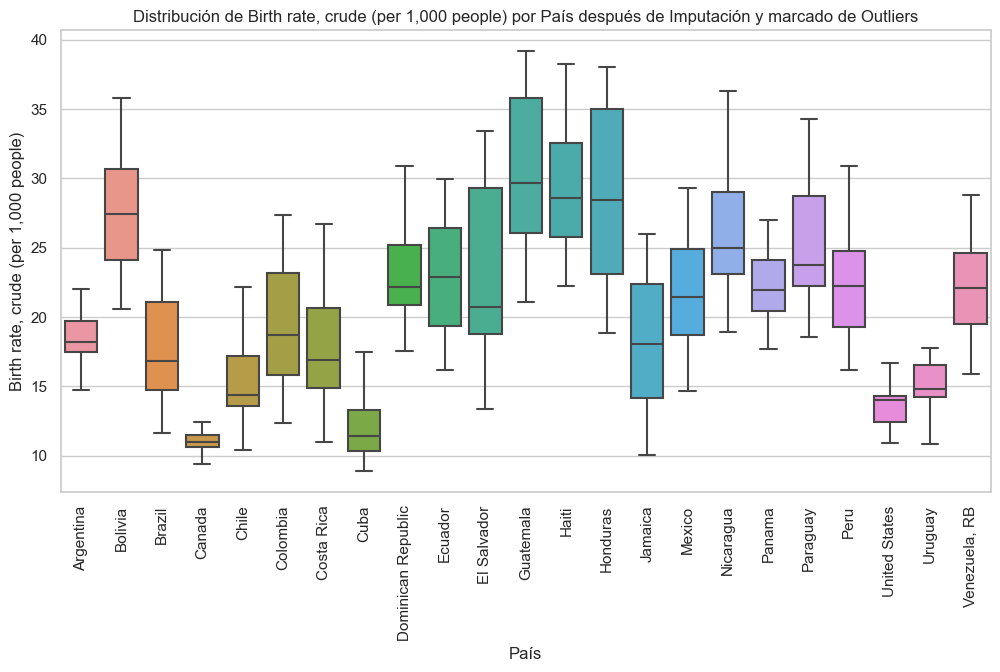

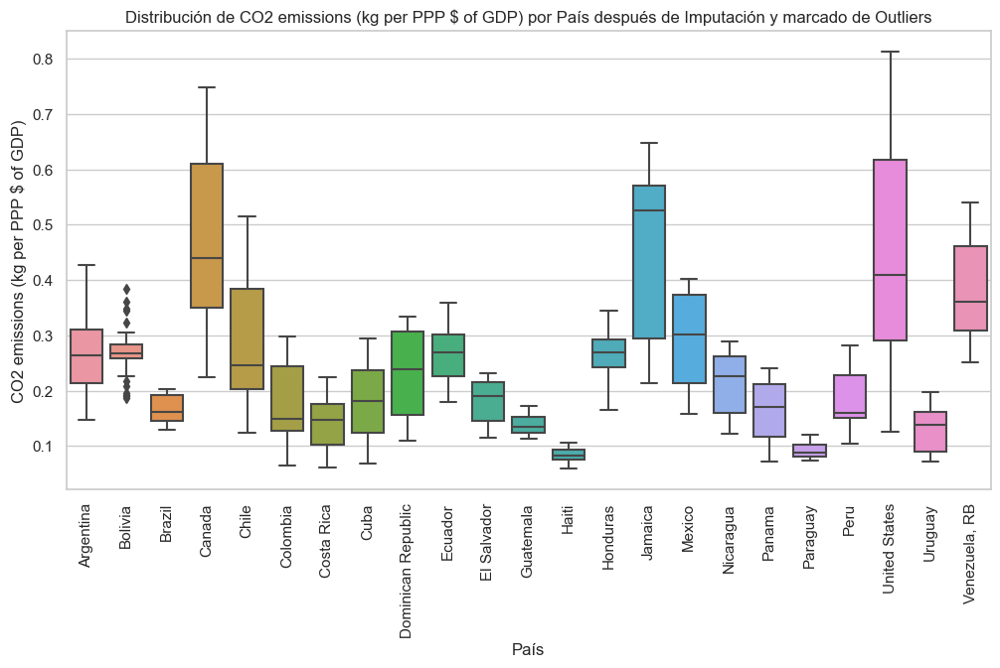

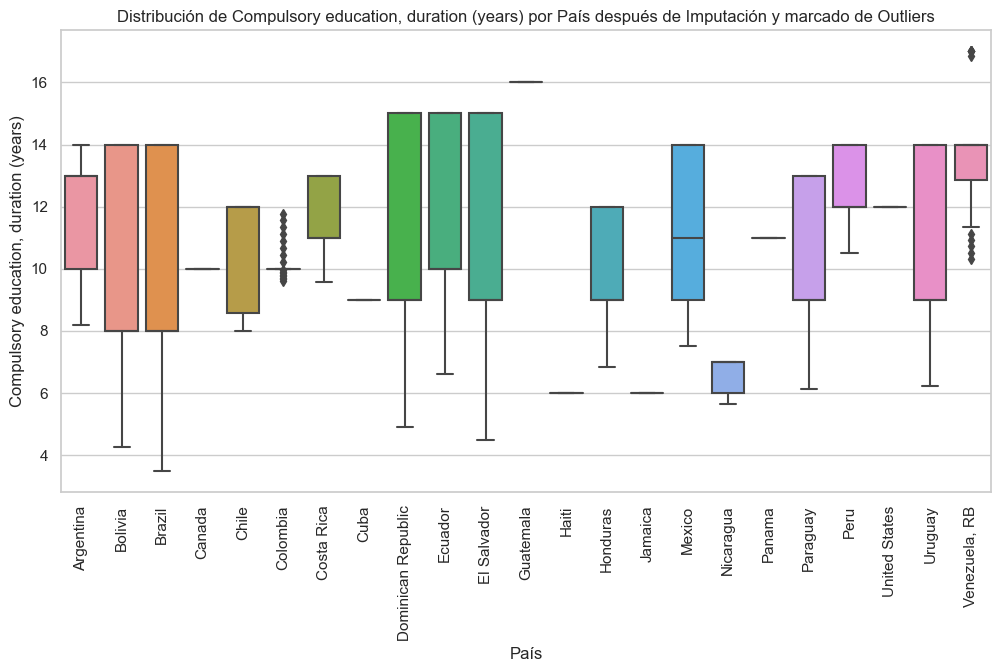

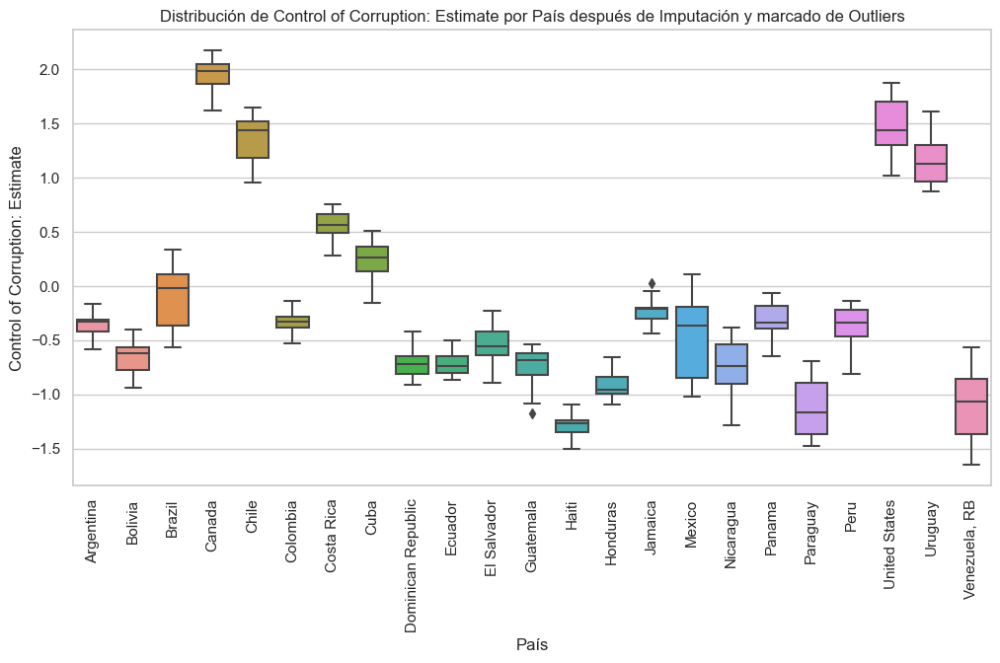

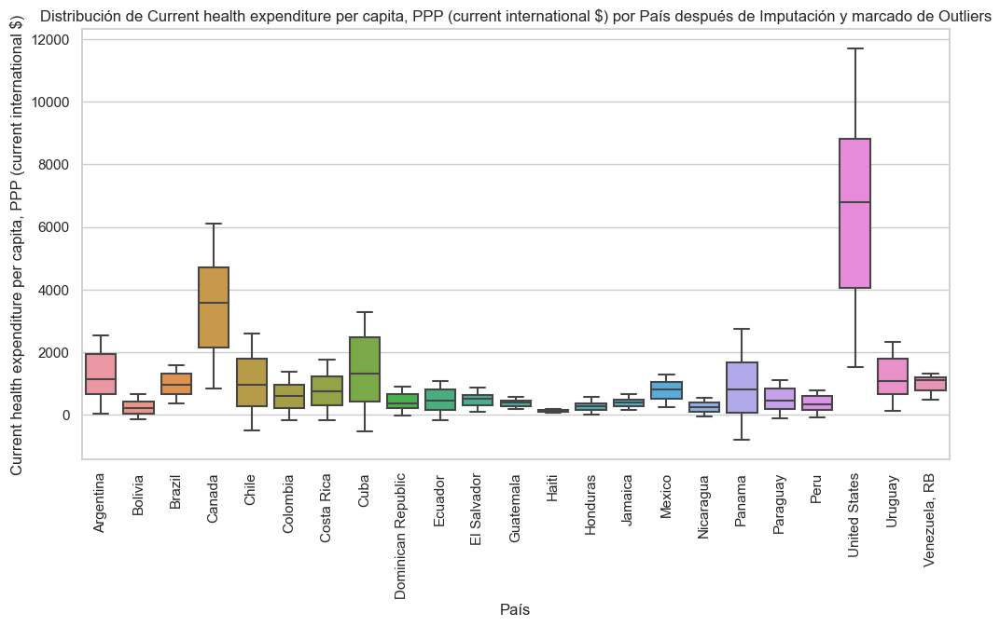

...

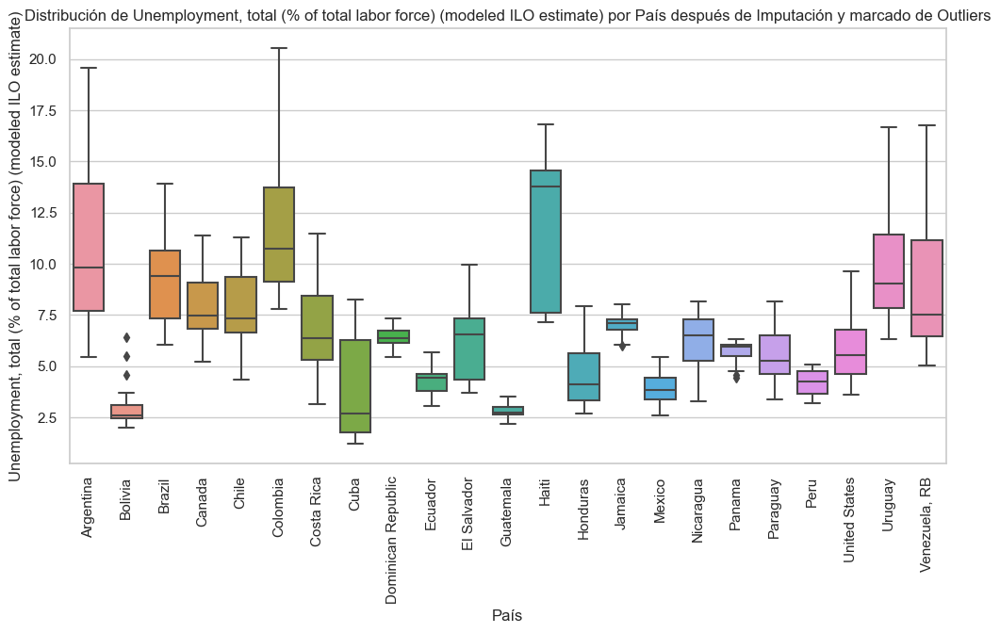

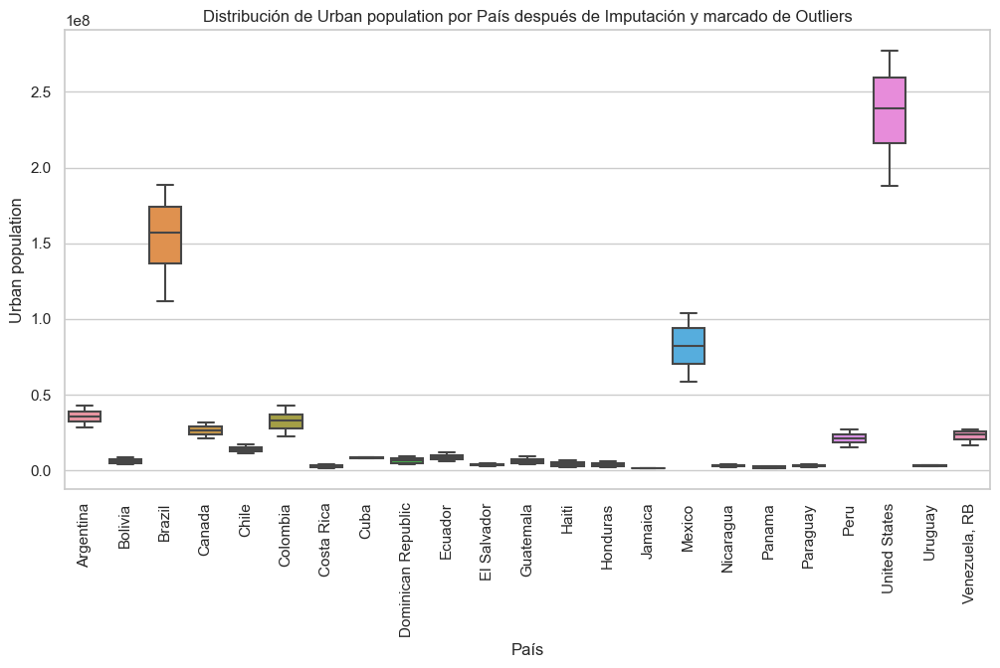

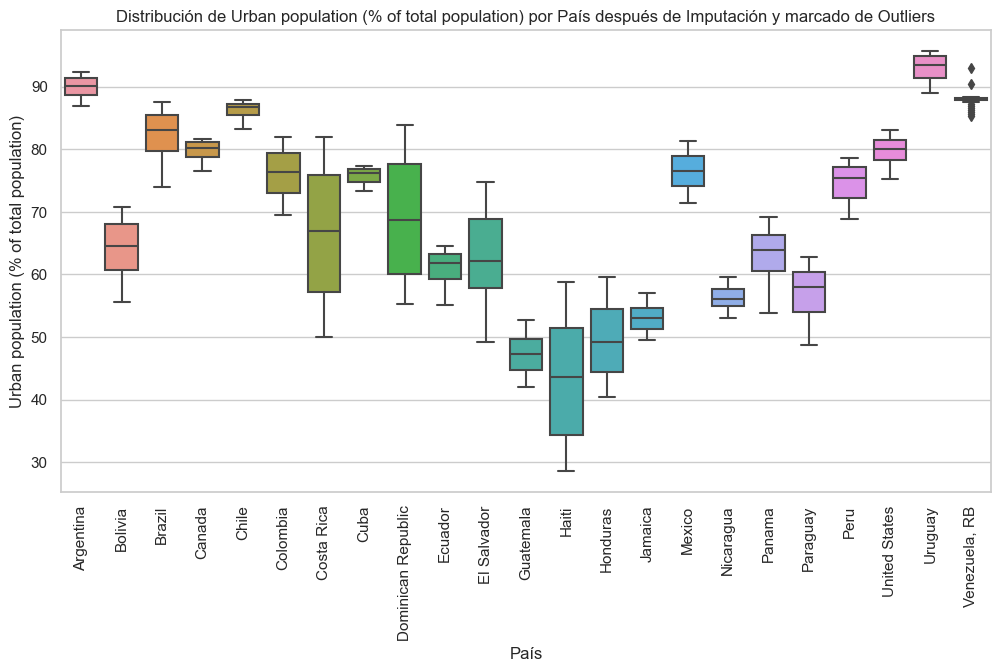

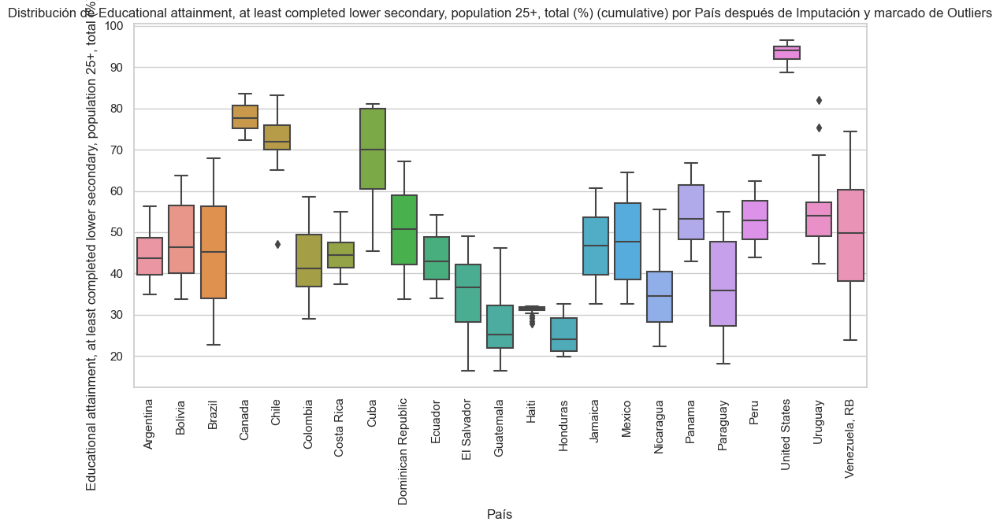

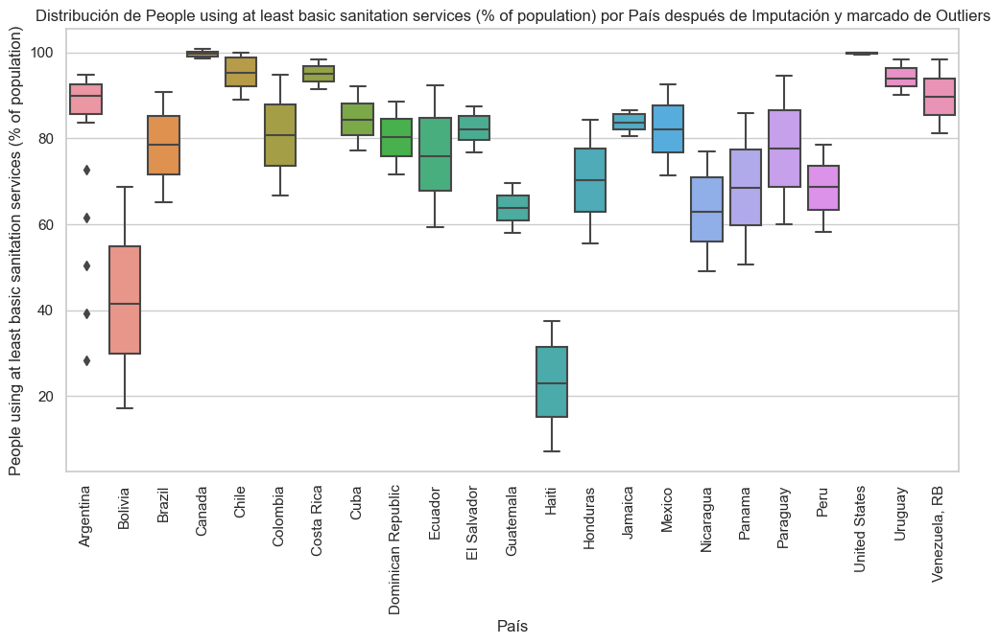

TypeError: Neither the `x` nor `y` variable appears to be numeric.

<Figure size 1200x600 with 0 Axes>

In [213]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Función para marcar outliers con NaN
def mark_outliers_with_nan(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_whisker = Q1 - 1.5 * IQR
    upper_whisker = Q3 + 1.5 * IQR
    
    # Identificar outliers
    outliers_mask = ((df[column] < lower_whisker) | (df[column] > upper_whisker))
    
    # Marcar outliers como NaN
    df.loc[outliers_mask, column] = np.nan
    return df

# Asumiendo que 'tabla_con_imputaciones' tiene valores imputados donde había NaNs
# y 'indicadores_validos' tiene la lista de indicadores con menos del 38% de nulos.

# Identificamos y marcamos outliers en 'tabla_con_imputaciones'
for _, row in indicadores_validos.iterrows():
    pais = row['País']
    indicador = row['Indicador']
    if indicador != 'Año':  # Excluir la columna 'Año'
        df_pais = tabla_con_imputaciones[tabla_con_imputaciones['País'] == pais].copy()
        df_pais = mark_outliers_with_nan(df_pais, indicador)
        tabla_con_imputaciones.loc[df_pais.index, indicador] = df_pais[indicador]

# Realizamos interpolación lineal donde se marcaron outliers como NaN
for indicador in tabla_con_imputaciones.columns[2:]:  # Excluir 'País' y 'Año'
    if indicador != 'Año':  # Excluir la columna 'Año'
        tabla_con_imputaciones[indicador].interpolate(method='linear', inplace=True)

# Asumiendo que 'tabla_sin_caribe' y 'indicadores_validos' ya están cargados.
# Configuramos el estilo visual de los gráficos
sns.set(style="whitegrid")

# Obtenemos la lista de indicadores únicos y países desde 'indicadores_validos'
indicadores_unicos = indicadores_validos['Indicador'].unique()
paises_unicos = indicadores_validos['País'].unique()

# Visualizamos los resultados con boxplots
for indicador in indicadores_unicos:
    if indicador != 'Año':  # Excluir la columna 'Año'
        plt.figure(figsize=(12, 6))
        sns.boxplot(x='País', y=indicador, data=tabla_con_imputaciones)
        plt.title(f'Distribución de {indicador} por País después de Imputación y marcado de Outliers')
        plt.xticks(rotation=90)
        plt.show()


Visualizamos las nuevas lineas tendencias con nulos imputados

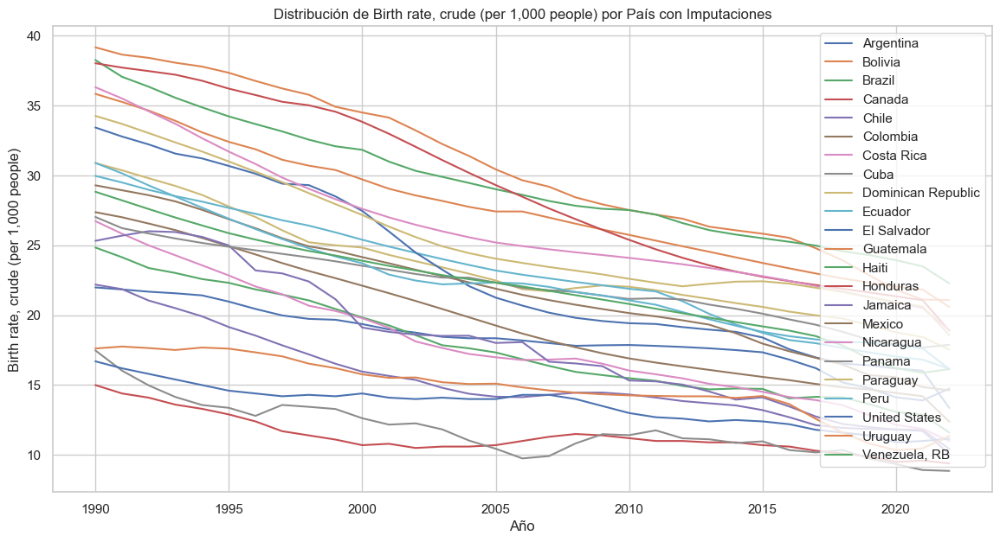

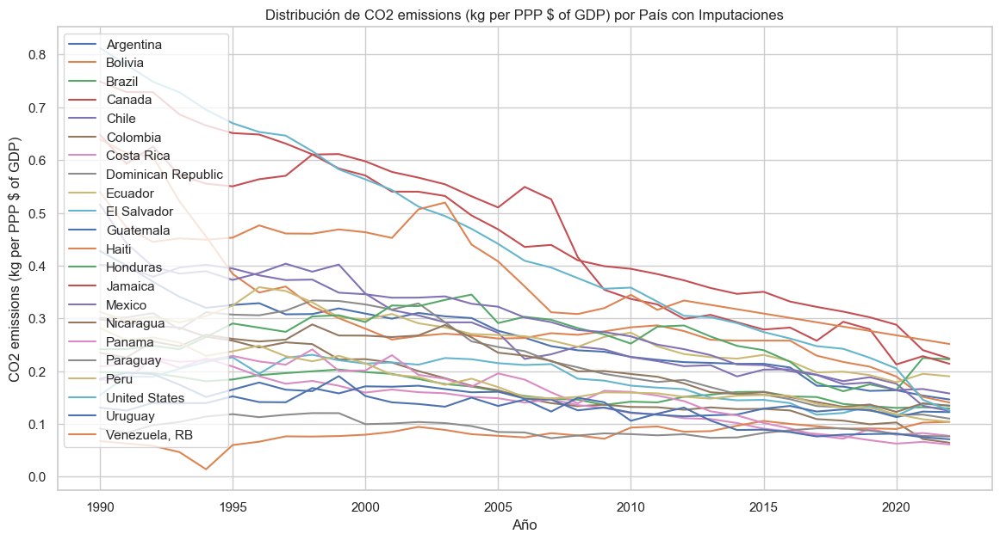

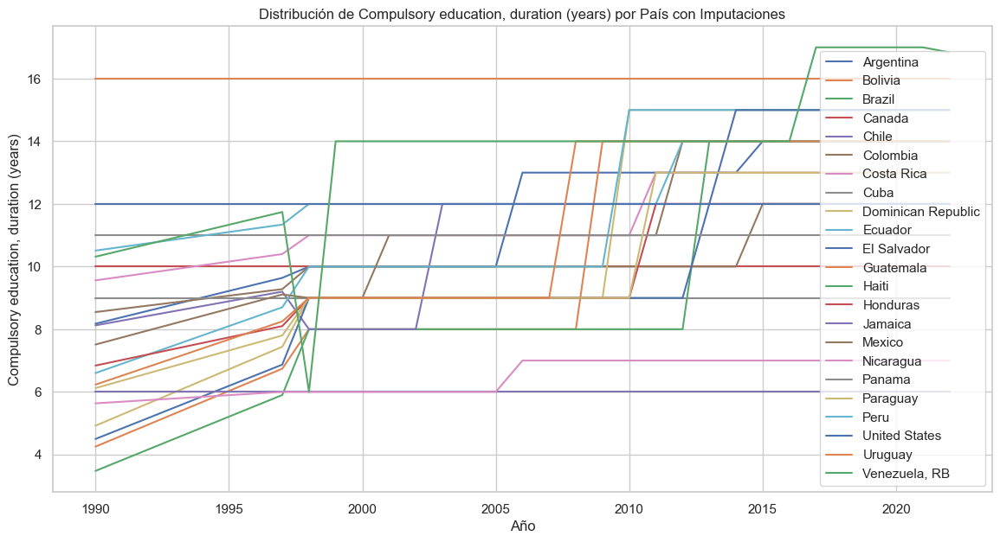

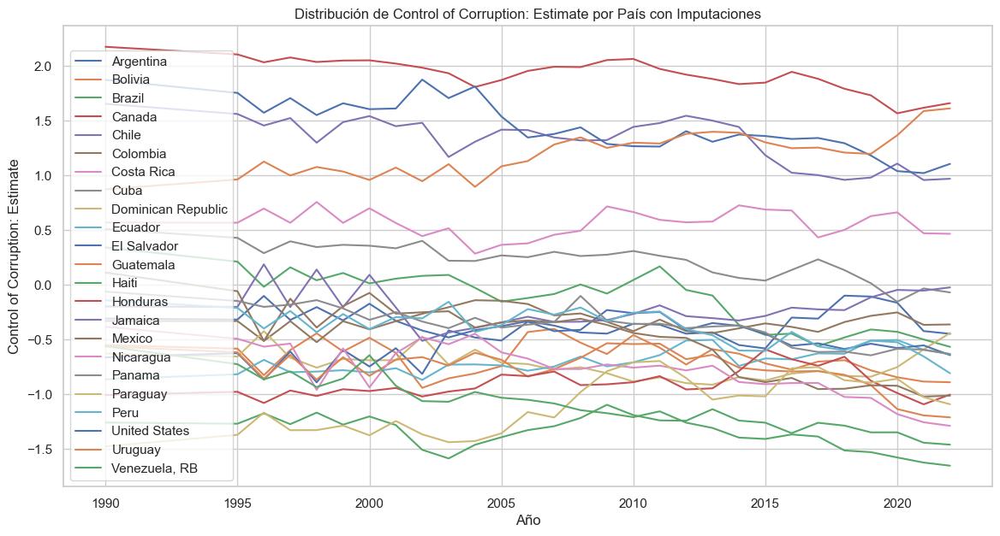

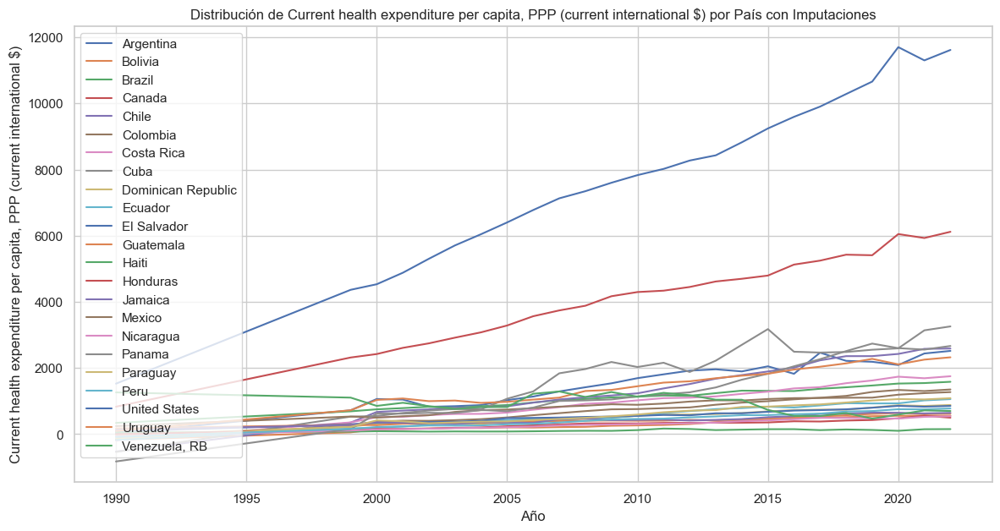

...

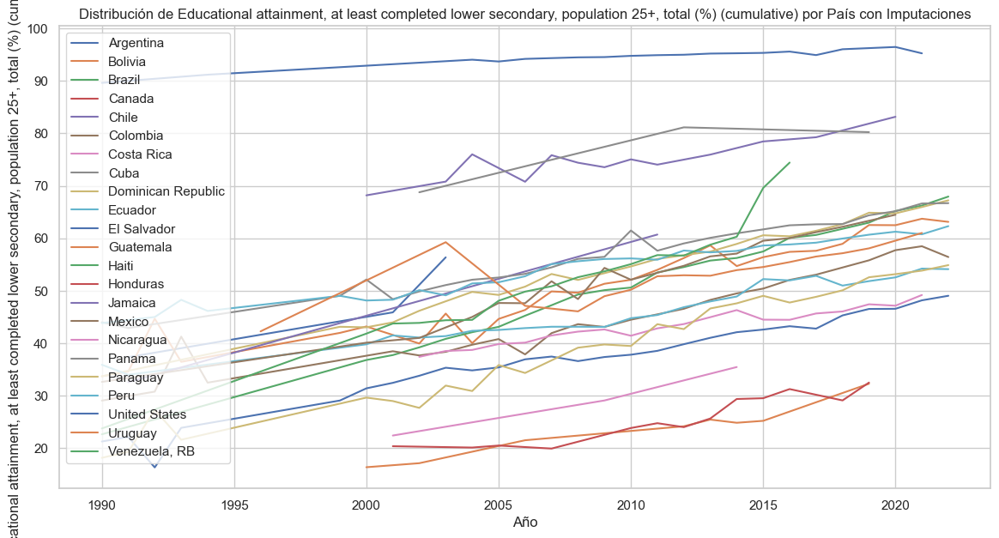

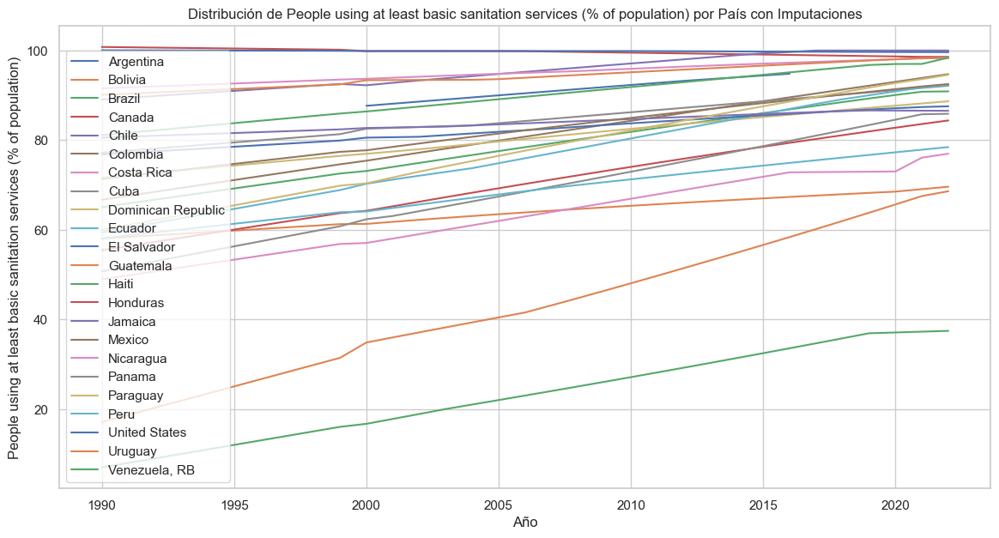

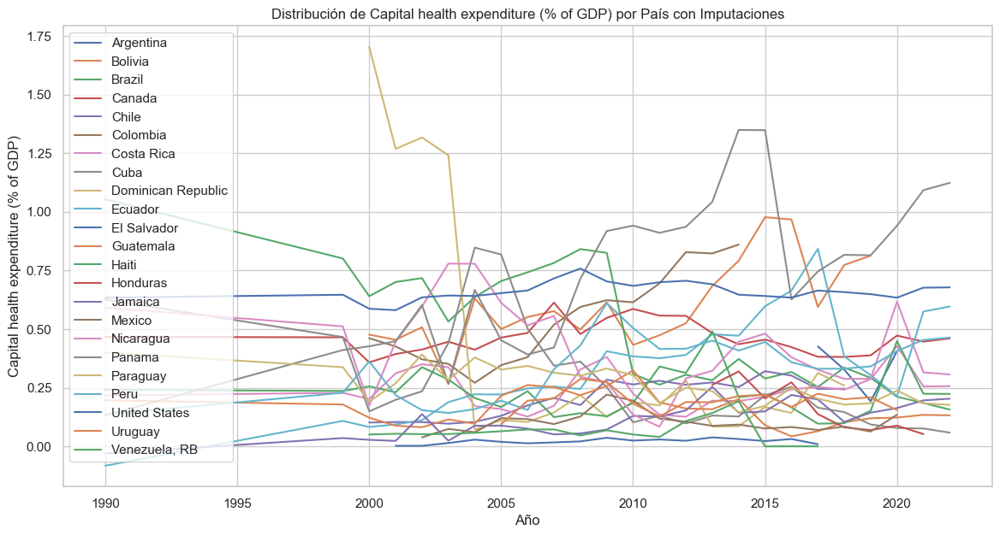

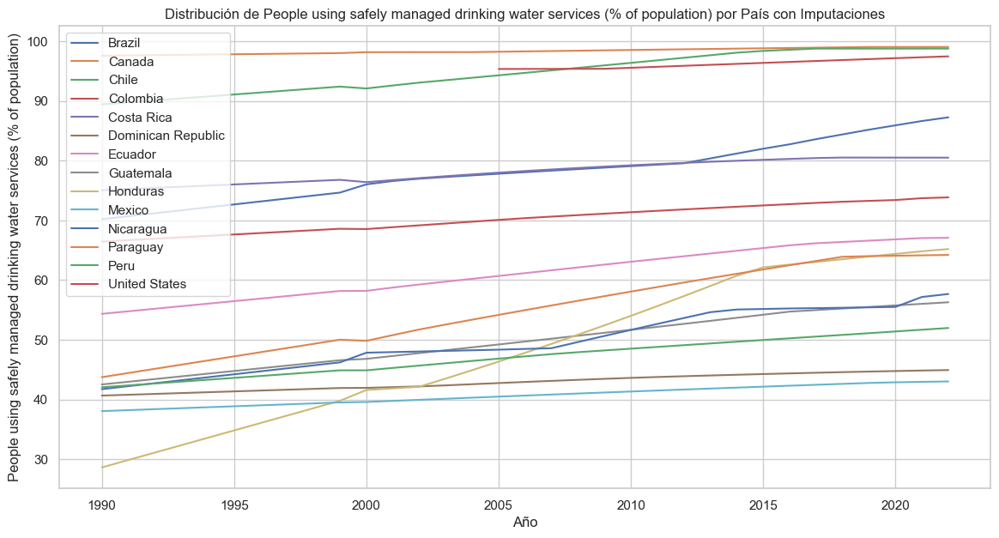

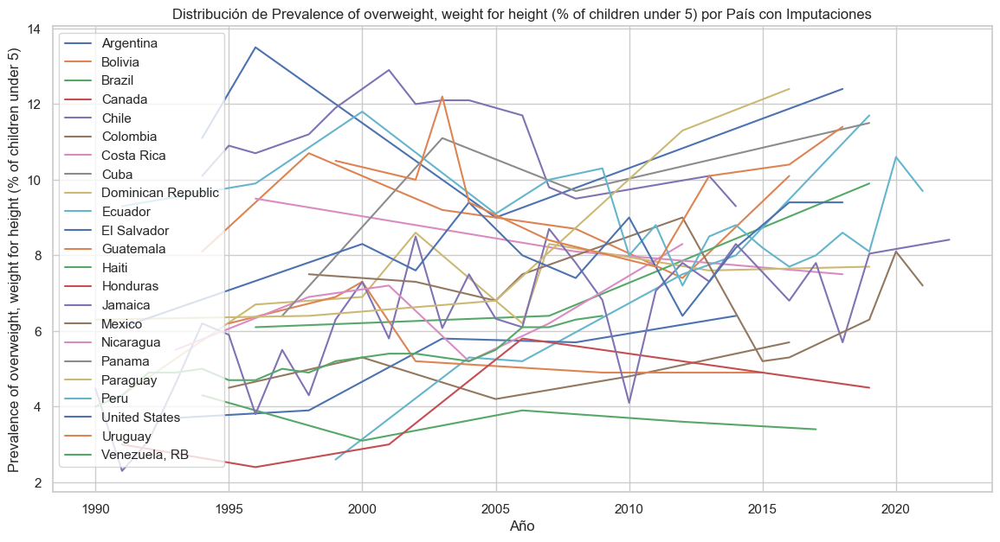

In [ ]:
#Analizamos neuvas tendencias con valores imputados de "indicadores validos" , que no superaron el umbral de nulos.


# Configuramos el estilo visual de los gráficos
sns.set(style="whitegrid")

# Obtenemos la lista de indicadores únicos sin incluir 'Año'
indicadores_unicos = indicadores_validos['Indicador'].unique()
if 'Año' in indicadores_unicos:
    indicadores_unicos = indicadores_unicos[indicadores_unicos != 'Año']

paises_unicos = indicadores_validos['País'].unique()

# Iteramos a través de cada indicador único para crear un gráfico que incluya todos los países
for indicador in indicadores_unicos:
    plt.figure(figsize=(14, 7))  # Ajusta el tamaño de la figura si es necesario
    
    for pais in paises_unicos:
        # Seleccionamos los datos para el país e indicador específicos
        datos_pais_indicador = tabla_con_imputaciones[
            (tabla_con_imputaciones['País'] == pais) & (tabla_con_imputaciones[indicador].notna())
        ]
        
        # Si hay datos para este país e indicador, los graficamos
        if not datos_pais_indicador.empty:
            sns.lineplot(
                x='Año',
                y=indicador,
                data=datos_pais_indicador,
                label=pais  # Etiquetamos cada línea con el nombre del país
            )
    
    # Añadimos título y etiquetas al gráfico
    plt.title(f'Distribución de {indicador} por País con Imputaciones')
    plt.xlabel('Año')
    plt.ylabel(indicador)
    plt.legend()  # Mostramos la leyenda para identificar los países
    plt.show()


Bonus Análisis de Regresión ejemplo, indicadores de Argentina. Incluye serie temporal original, linea de regresion y linea corregida por los datos de la regresión. (Es válido el análisis para cada país)

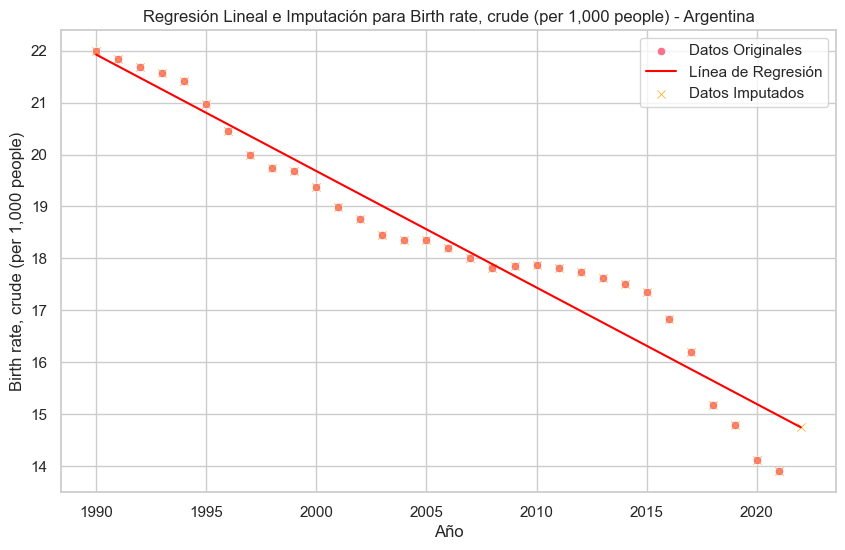

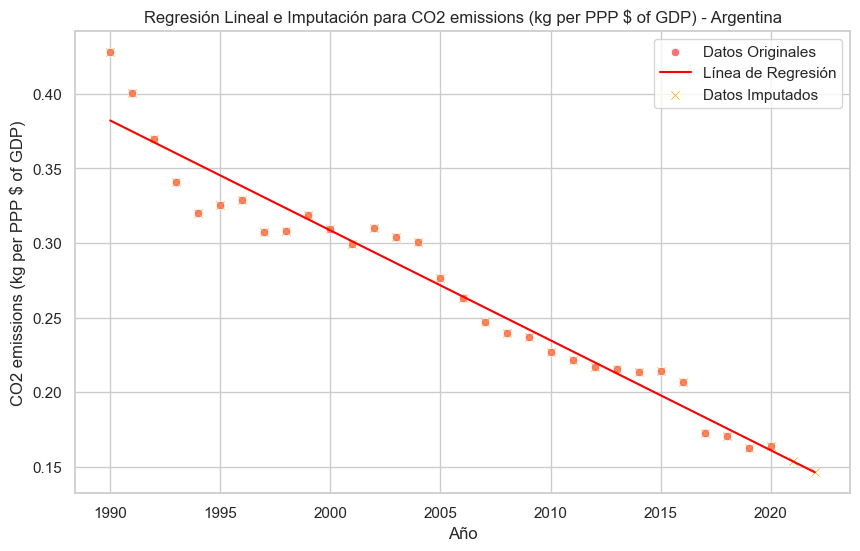

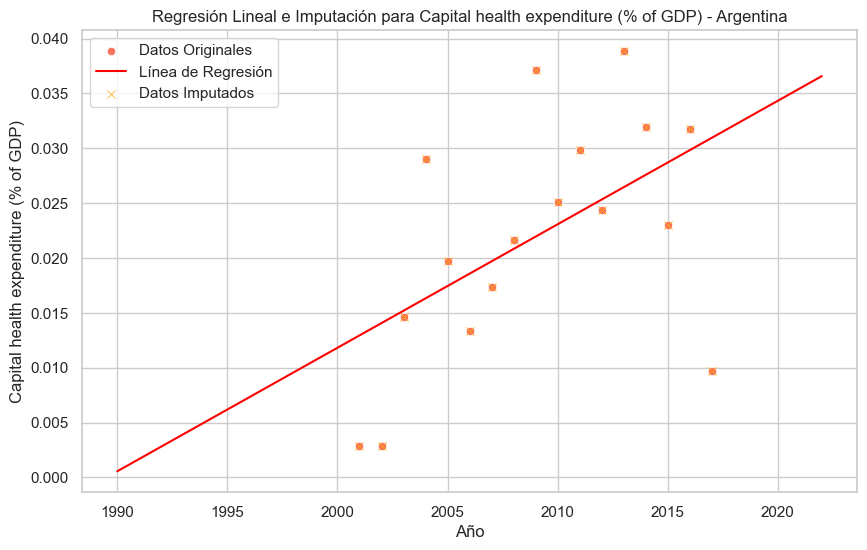

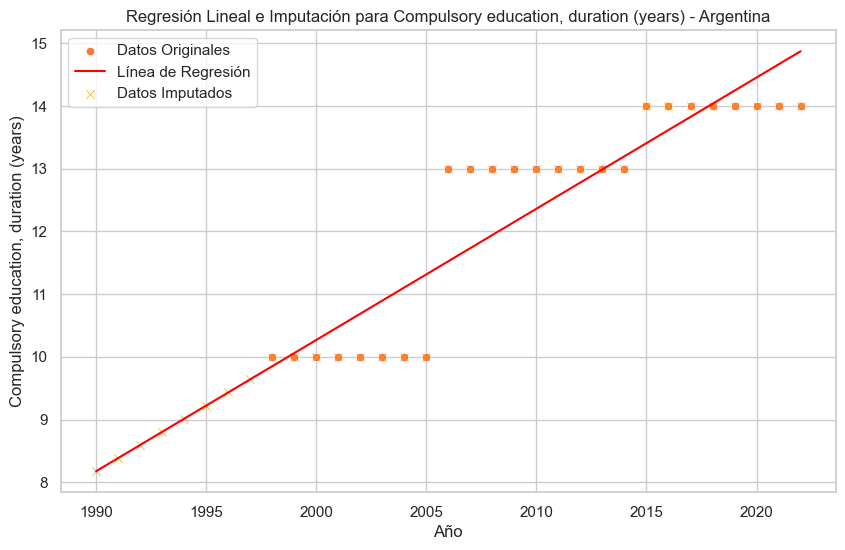

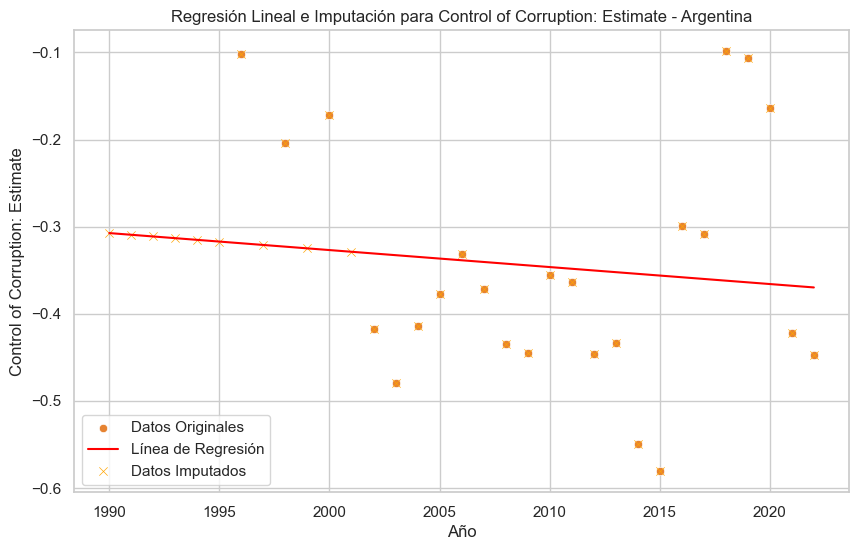

...

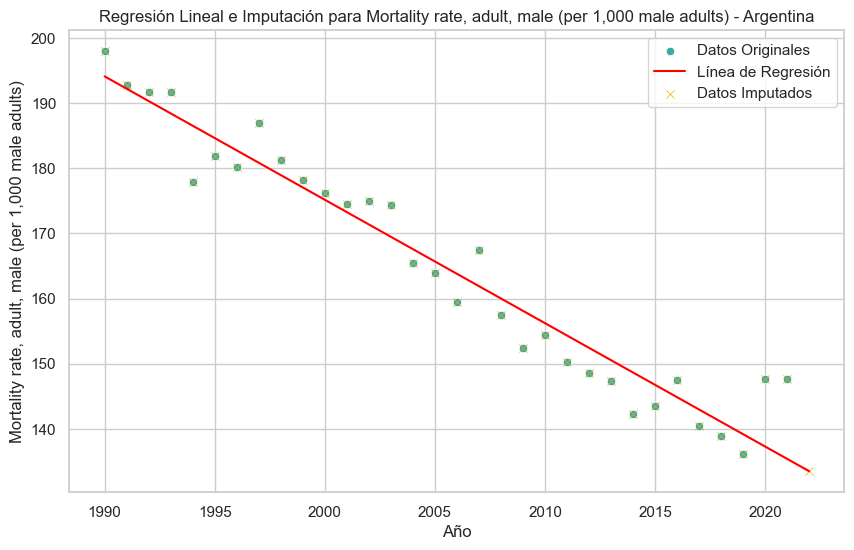

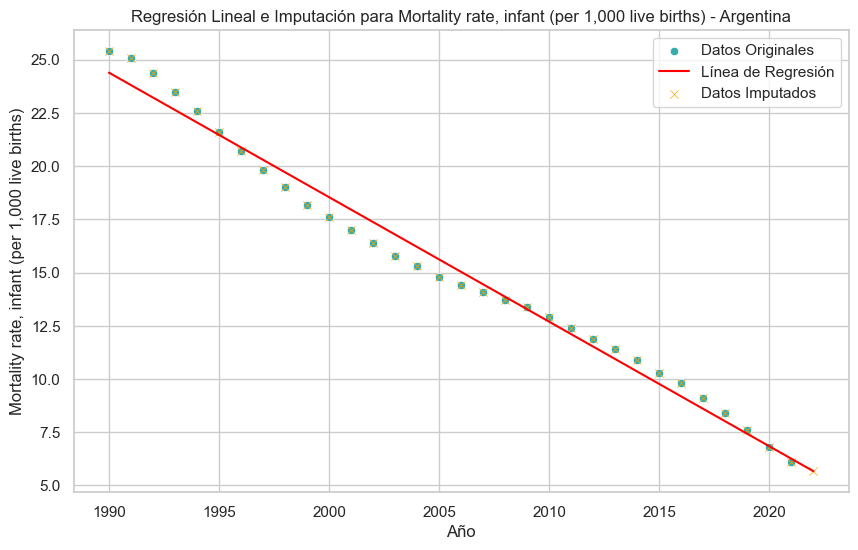

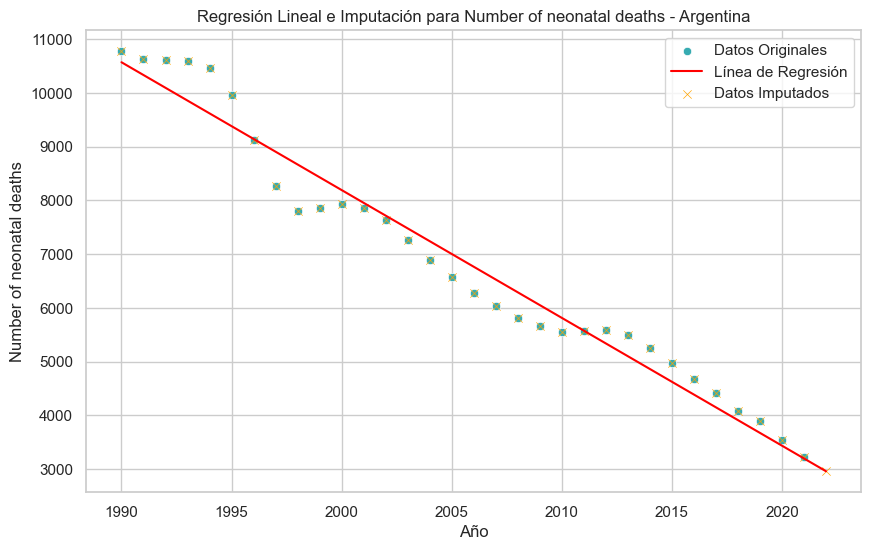

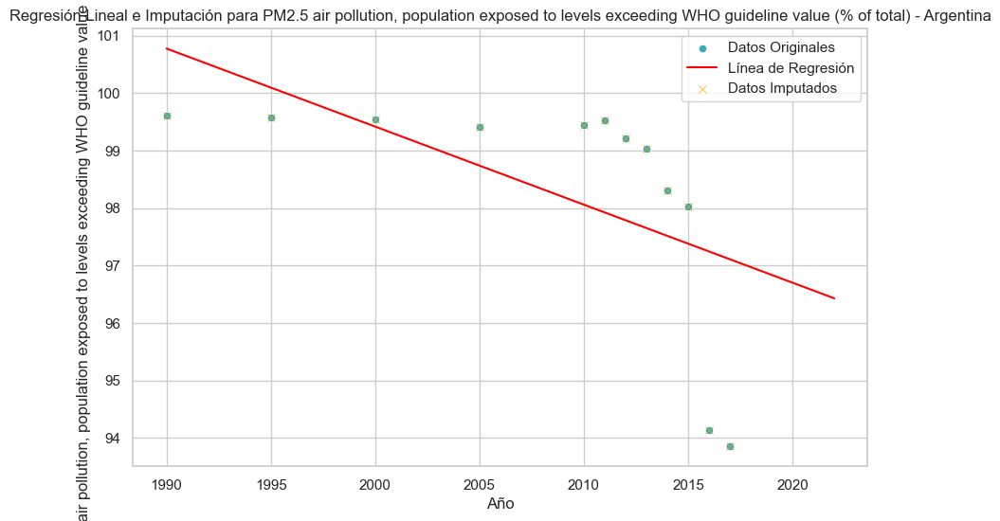

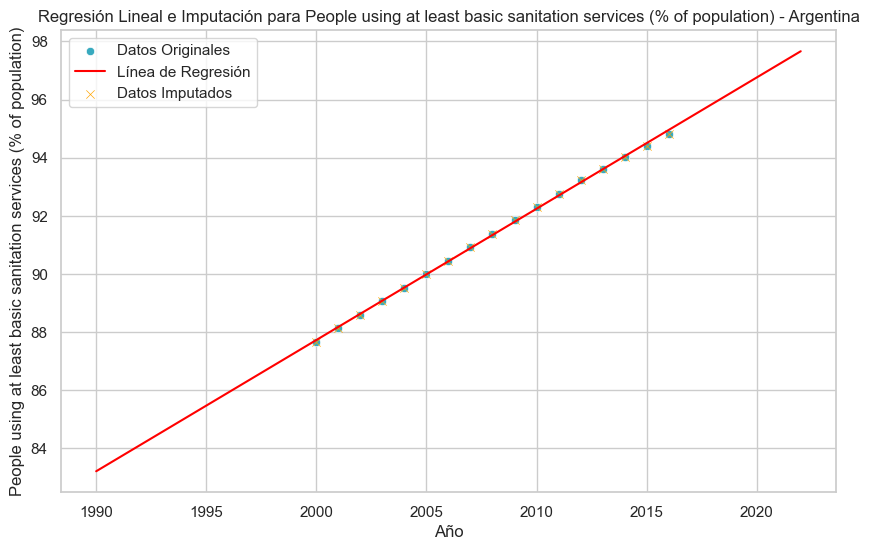

No hay suficientes datos para realizar una regresión para el indicador People using safely managed drinking water services (% of population).


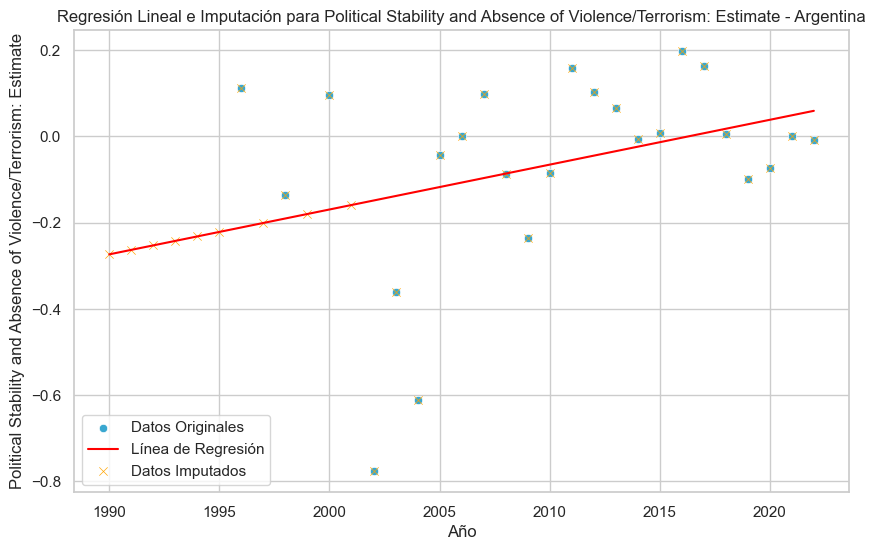

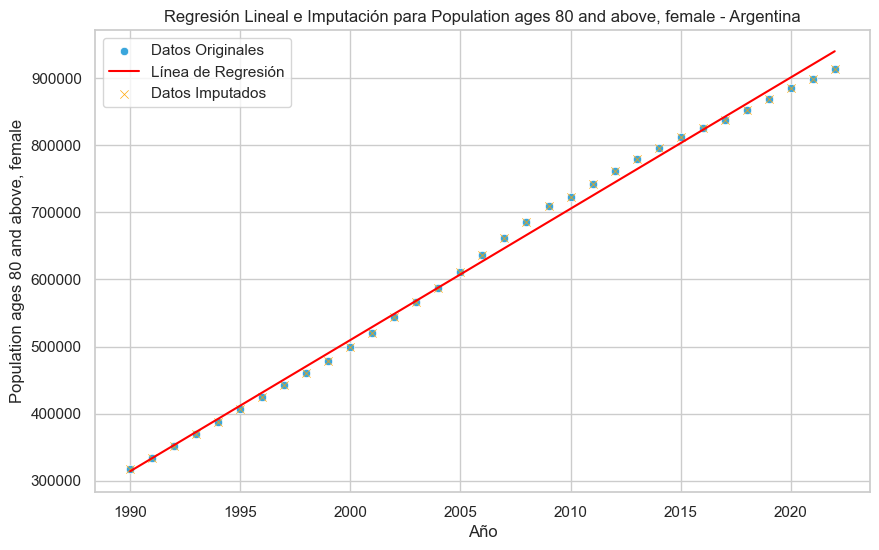

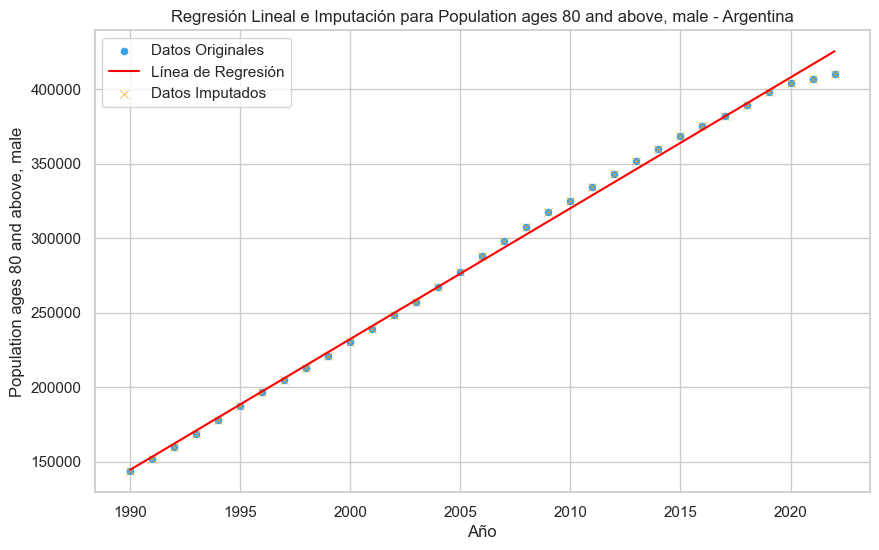

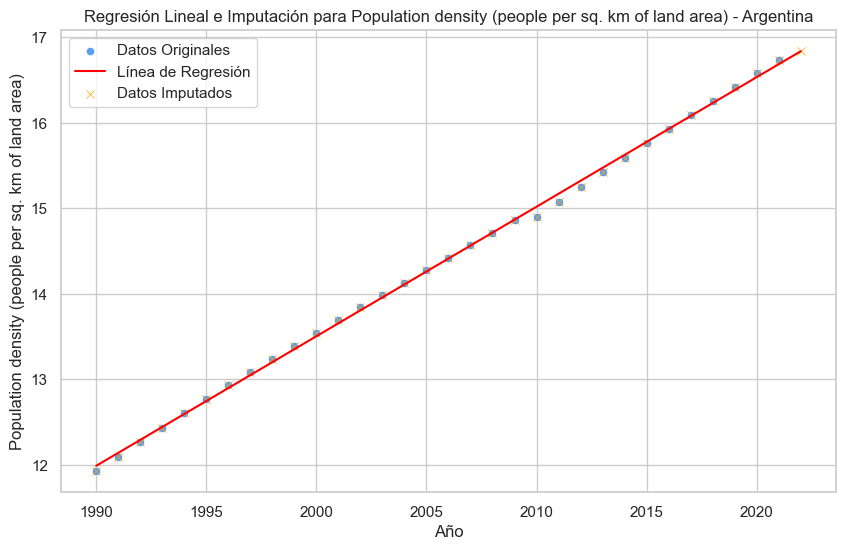

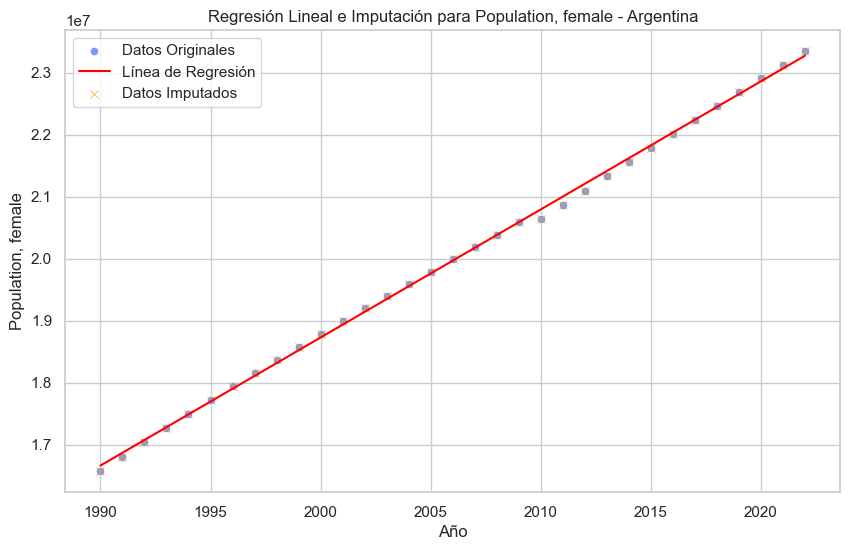

...

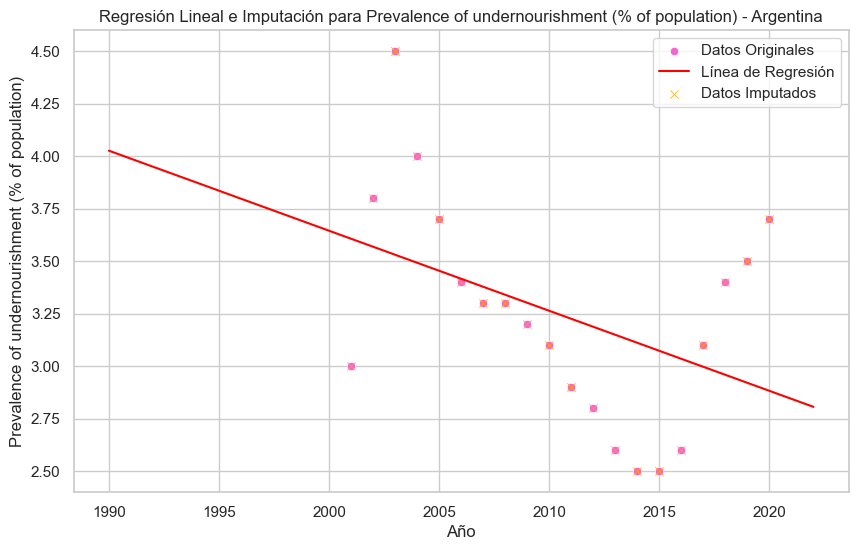

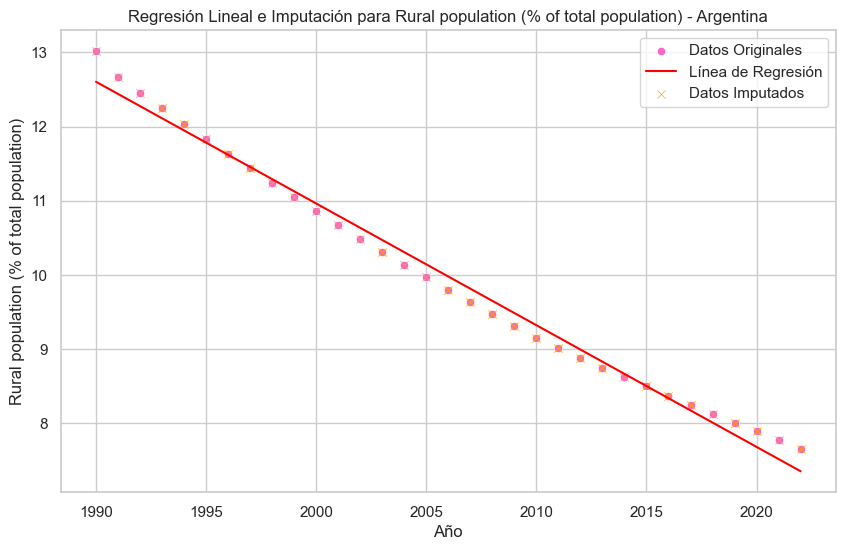

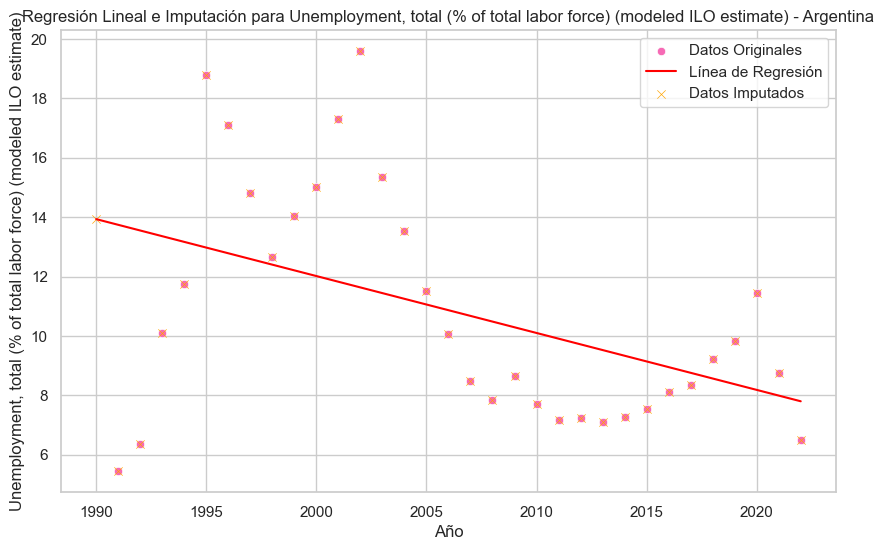

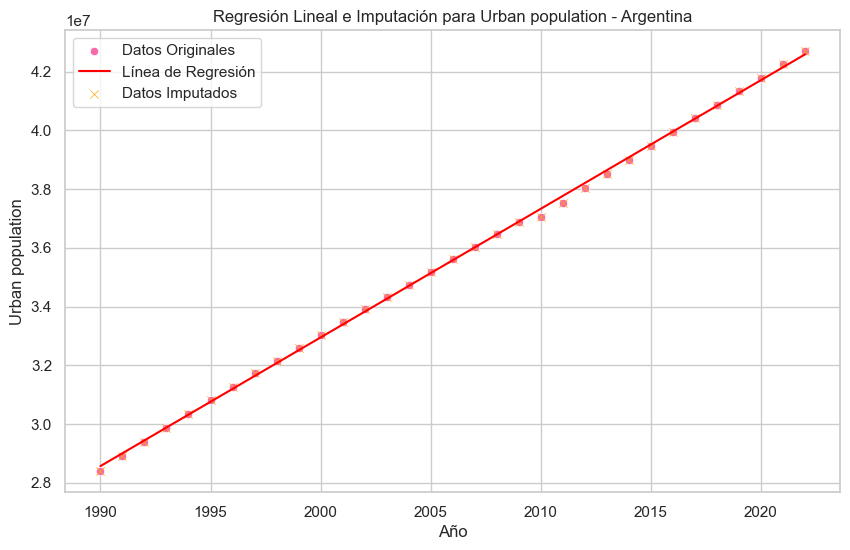

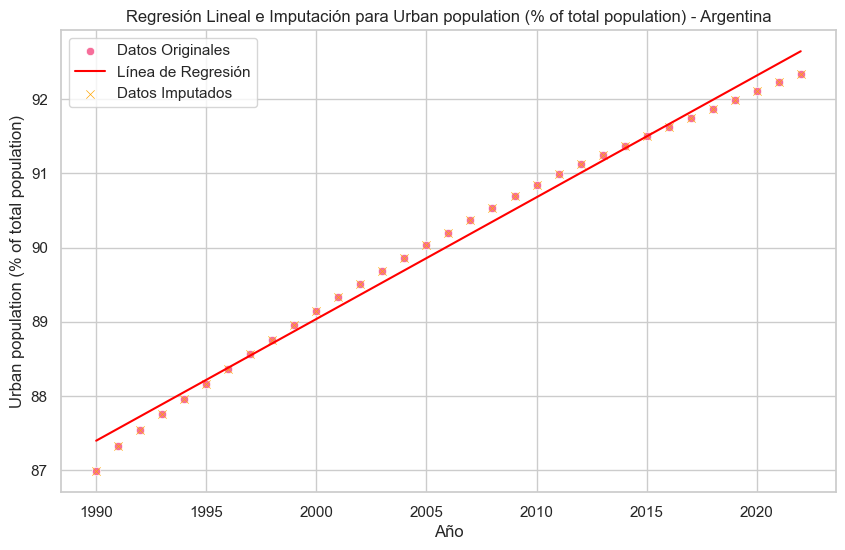

In [ ]:
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
import seaborn as sns

# Asegúrate de que 'tabla_sin_caribe' y 'tabla_con_imputaciones' estén cargados correctamente
indicadores = tabla_sin_caribe.columns[2:]  # Suponiendo que las columnas de indicadores comienzan en la tercera columna

# Filtra los datos solo para el país "Argentina"
argentina_datos_originales = tabla_sin_caribe[tabla_sin_caribe['País'] == 'Argentina']
argentina_datos_imputados = tabla_con_imputaciones[tabla_con_imputaciones['País'] == 'Argentina']

# Define una paleta de colores
colores = sns.color_palette("husl", len(indicadores))

# Itera a través de cada indicador
for indicador, color in zip(indicadores, colores):
    # Prepara los datos para la regresión
    data_known = argentina_datos_originales[argentina_datos_originales[indicador].notna()]
    X_train = data_known[['Año']].values.reshape(-1, 1)
    y_train = data_known[indicador].values

    # Entrena el modelo de regresión lineal si hay suficientes datos
    if len(X_train) >= 2:
        model = LinearRegression()
        model.fit(X_train, y_train)

        # Realiza predicciones para todos los años
        X_full = argentina_datos_originales[['Año']].values.reshape(-1, 1)
        y_pred_full = model.predict(X_full)

        # Crea un gráfico
        plt.figure(figsize=(10, 6))
        # Datos originales
        sns.scatterplot(x='Año', y=indicador, data=argentina_datos_originales, label='Datos Originales', color=color)
        # Línea de regresión basada en datos originales
        sns.lineplot(x=argentina_datos_originales['Año'], y=y_pred_full, label='Línea de Regresión', color='red')
        # Datos imputados
        sns.scatterplot(x='Año', y=indicador, data=argentina_datos_imputados, label='Datos Imputados', color='orange', marker='x')

        # Título y etiquetas
        plt.title(f'Regresión Lineal e Imputación para {indicador} - Argentina')
        plt.xlabel('Año')
        plt.ylabel(indicador)
        plt.legend()
        plt.show()
    else:
        print(f"No hay suficientes datos para realizar una regresión para el indicador {indicador}.")


Correlaciones. Hacemos una tabla de correlaciones y graficamos las correlaciones que existen entre cada indicador con la esperanza de vida, por país. Luego acotamos el analisis a los indicadores que tienen las 15 correlaciones más altas con la essperanza de vida, por país.

In [ ]:
#Volvemos a cero los nulos  de la tabla
tabla_con_imputaciones = tabla_con_imputaciones.fillna(0)


In [ ]:
import pandas as pd



# Selecciona las columnas de indicadores desde la tercera columna en adelante, excluyendo 'País' y 'Año'
columnas_indicadores = tabla_con_imputaciones.columns[2:]

# Crea un diccionario para almacenar las correlaciones por país
correlaciones_dict = {'País': []}
for indicador in columnas_indicadores:
    correlaciones_dict[indicador] = []

# Itera a través de cada país
for pais in tabla_con_imputaciones['País'].unique():
    datos_pais = tabla_con_imputaciones[tabla_con_imputaciones['País'] == pais]
    # Asegúrate de usar el nombre correcto de la columna de esperanza de vida
    esperanza_de_vida = datos_pais['Life expectancy at birth, total (years)']
    
    # Calcula las correlaciones entre la esperanza de vida y los indicadores para este país
    correlaciones_dict['País'].append(pais)
    for indicador in columnas_indicadores:
        # Asegúrate de que tanto el indicador como la esperanza de vida no contengan NaNs antes de calcular la correlación
        if not datos_pais[indicador].isnull().any() and not esperanza_de_vida.isnull().any():
            correlacion = datos_pais[indicador].corr(esperanza_de_vida)
            correlaciones_dict[indicador].append(correlacion)
        else:
            # Si hay NaNs, entonces la correlación no puede ser calculada
            correlaciones_dict[indicador].append(None)

# Crea un DataFrame a partir del diccionario de correlaciones
correlaciones_df = pd.DataFrame(correlaciones_dict)

# Ahora 'correlaciones_df' contiene las correlaciones por país


In [ ]:
correlaciones_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23 entries, 0 to 22
Data columns (total 49 columns):
 #   Column                                                                                              Non-Null Count  Dtype  
---  ------                                                                                              --------------  -----  
 0   País                                                                                                23 non-null     object 
 1   Birth rate, crude (per 1,000 people)                                                                23 non-null     float64
 2   CO2 emissions (kg per PPP $ of GDP)                                                                 22 non-null     float64
 3   Capital health expenditure (% of GDP)                                                               23 non-null     float64
 4   Compulsory education, duration (years)                                                              16 non-null     fl

In [ ]:
correlaciones_df.head(50)

,País,"Birth rate, crude (per 1,000 people)",CO2 emissions (kg per PPP $ of GDP),Capital health expenditure (% of GDP),"Compulsory education, duration (years)",Control of Corruption: Estimate,"Current health expenditure per capita, PPP (current international $)","Death rate, crude (per 1,000 people)",Domestic general government health expenditure (% of GDP),"Domestic general government health expenditure per capita, PPP (current international $)",...,"Population, total",Poverty gap at $6.85 a day (2017 PPP) (%),Pregnant women receiving prenatal care (%),Prevalence of overweight (% of adults),"Prevalence of overweight, weight for height (% of children under 5)",Prevalence of undernourishment (% of population),Rural population (% of total population),"Unemployment, total (% of total labor force) (modeled ILO estimate)",Urban population,Urban population (% of total population)
0,Argentina,-0.876695,-0.934678,0.523134,0.934510,-0.222972,0.948466,0.080431,0.922207,0.946596,...,0.945136,-0.505064,-0.013947,0.949322,-0.064860,0.608619,-0.962323,-0.495516,0.946184,0.962323
1,Bolivia,-0.941181,-0.851485,0.743027,0.882912,-0.288489,0.881961,-0.981595,0.855046,0.872391,...,0.903640,-0.912134,0.069330,0.915932,0.029589,0.531180,-0.937904,0.181297,0.901200,0.937904
2,Brazil,-0.980629,-0.868375,-0.882405,0.884285,-0.857689,0.966036,-0.227389,0.821811,0.961241,...,0.980063,-0.974809,0.065375,0.969401,0.126427,0.287813,-0.976937,0.479158,0.979701,0.976937
3,Canada,-0.818779,-0.992263,0.045669,NaN,-0.805243,0.983615,0.550001,0.927259,0.976680,...,0.974297,-0.781930,0.037685,0.984835,-0.020617,0.637841,-0.969506,-0.754382,0.981452,0.969506
4,Chile,-0.974400,-0.958105,0.625920,0.831674,-0.751995,0.953996,0.650775,0.930060,0.945270,...,0.949160,-0.522320,-0.263859,0.963229,-0.208320,0.663431,-0.968102,0.295298,0.957092,0.968102
5,Colombia,-0.958302,-0.933350,0.353527,0.794486,-0.036235,0.924115,-0.317996,0.875082,0.919835,...,0.927267,-0.924306,-0.009293,0.934279,0.028387,0.588336,-0.944126,-0.296314,0.926882,0.944126
6,Costa Rica,-0.865620,-0.845198,0.048502,0.830488,-0.076611,0.855104,0.483455,0.813216,0.854837,...,0.885116,-0.878125,0.028690,0.864655,0.003010,0.716344,-0.880030,0.558296,0.872313,0.880030
7,Cuba,-0.718808,NaN,-0.546598,NaN,-0.602601,0.741531,0.224655,0.722125,0.740002,...,0.870454,NaN,0.374821,0.740112,0.144358,0.819976,-0.831081,-0.809924,0.861009,0.831081
8,Dominican Republic,-0.958062,-0.928319,-0.099535,0.929701,-0.495264,0.970384,0.203965,0.936774,0.964325,...,0.982897,-0.845900,-0.070066,0.981244,-0.027564,0.250907,-0.981560,0.061504,0.977087,0.981560
9,Ecuador,-0.865108,-0.742191,0.866882,0.837356,0.661766,0.872712,-0.486435,0.866009,0.870050,...,0.848573,-0.889113,-0.190819,0.865659,0.346098,0.454420,-0.905500,-0.578210,0.858899,0.905500


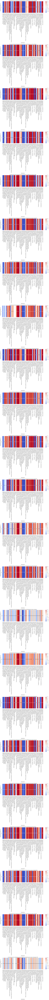

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que 'correlaciones' es tu DataFrame con las correlaciones

# Obtiene la lista de países únicos en el DataFrame de correlaciones
paises = correlaciones_df['País'].unique()

# Define el tamaño de la figura para cada mapa de calor
fig, axes = plt.subplots(len(paises), figsize=(14, 10 * len(paises)))  # Aumenta el espacio en el eje Y

# Itera a través de cada país y crea un mapa de calor
for i, pais in enumerate(paises):
    # Filtra el DataFrame para el país actual
    correlaciones_pais = correlaciones_df[correlaciones_df['País'] == pais]

    # Elimina la columna 'País' para que no aparezca en el mapa de calor
    correlaciones_pais = correlaciones_pais.drop(columns=['País'])

    # Crea el mapa de calor para el país actual en el subplot correspondiente
    ax = axes[i]
    
    # Aumenta el tamaño de la fuente en los números de correlación
    sns.heatmap(correlaciones_pais, ax=ax, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 8})
    
    ax.set_title(f'Correlaciones de los indicadores socioeconómicos y la Esperanza de vida en {pais}')
    ax.set_xlabel('Indicadores')
    ax.set_ylabel('Esperanza de Vida (E. V)')

# Ajusta el espaciado entre subplots
plt.tight_layout()

# Aumenta el espacio en el eje Y
plt.subplots_adjust(left=0.15)  # Puedes ajustar el valor según tus necesidades

# Muestra los mapas de calor para cada país
plt.show()


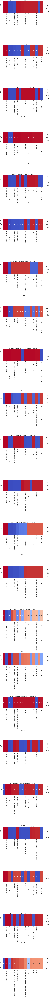

In [ ]:
#Ahora vemos solo las 15 correlaciones más altas de los indicadores socioeconómicos, respecto de la esperanza de vida por país

import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que 'correlaciones' es tu DataFrame con las correlaciones

# Obtiene la lista de países únicos en el DataFrame de correlaciones
paises = correlaciones_df['País'].unique()

# Define el tamaño de la figura para cada mapa de calor
fig, axes = plt.subplots(len(paises), figsize=(14, 10 * len(paises)))  # Aumenta el espacio en el eje Y

# Itera a través de cada país y crea un mapa de calor
for i, pais in enumerate(paises):
    # Filtra el DataFrame para el país actual
    correlaciones_pais = correlaciones_df[correlaciones_df['País'] == pais]

    # Elimina la columna 'País' y 'Life expectancy at birth, total (years)'
    correlaciones_pais = correlaciones_pais.drop(columns=['País', 'Life expectancy at birth, total (years)'])

    # Encuentra las 15 correlaciones más altas para el país actual
    top_correlaciones = correlaciones_pais.abs().mean().nlargest(15)

    # Filtra el DataFrame para incluir solo las correlaciones más altas
    correlaciones_top = correlaciones_pais[top_correlaciones.index]

    # Crea el mapa de calor para el país actual en el subplot correspondiente
    ax = axes[i]

    # Aumenta el tamaño de la fuente en los números de correlación
    sns.heatmap(correlaciones_top, ax=ax, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 8})

    ax.set_title(f'Correlaciones más altas de indicadores con la Esperanza de Vida en {pais}')
    ax.set_xlabel('Indicadores')
    ax.set_ylabel('Esperanza de Vida (E. V)')

# Ajusta el espaciado entre subplots
plt.tight_layout()

# Aumenta el espacio en el eje Y
plt.subplots_adjust(left=0.15)  # Puedes ajustar el valor según tus necesidades

# Muestra los mapas de calor para cada país
plt.show()


In [ ]:
tabla_con_imputaciones.head()

,País,Año,"Birth rate, crude (per 1,000 people)",CO2 emissions (kg per PPP $ of GDP),Capital health expenditure (% of GDP),"Compulsory education, duration (years)",Control of Corruption: Estimate,"Current health expenditure per capita, PPP (current international $)","Death rate, crude (per 1,000 people)",Domestic general government health expenditure (% of GDP),...,"Population, total",Poverty gap at $6.85 a day (2017 PPP) (%),Pregnant women receiving prenatal care (%),Prevalence of overweight (% of adults),"Prevalence of overweight, weight for height (% of children under 5)",Prevalence of undernourishment (% of population),Rural population (% of total population),"Unemployment, total (% of total labor force) (modeled ILO estimate)",Urban population,Urban population (% of total population)
0,Argentina,1990,21.989,0.427859,0.0,8.175385,-0.307430,18.598630,7.743,2.314777,...,32637657.0,10.226619,0.0,48.7,0.0,0.0,13.016,13.93446,28389540.0,86.984
1,Argentina,1991,21.844,0.400371,0.0,8.384615,-0.309380,96.672061,7.536,2.462353,...,33105763.0,4.500000,0.0,49.3,0.0,0.0,12.672,5.44000,28910601.0,87.328
2,Argentina,1992,21.683,0.369563,0.0,8.593846,-0.311330,174.745492,7.595,2.609929,...,33568285.0,5.000000,0.0,49.9,0.0,0.0,12.458,6.36000,29386348.0,87.542
3,Argentina,1993,21.570,0.340845,0.0,8.803077,-0.313281,252.818923,7.631,2.757505,...,34027240.0,5.500000,95.0,50.5,0.0,0.0,12.248,10.10000,29859584.0,87.752
4,Argentina,1994,21.419,0.320044,0.0,9.012308,-0.315231,330.892354,7.403,2.905081,...,34488696.0,5.700000,0.0,51.1,11.1,0.0,12.040,11.76000,30336257.0,87.960


In [ ]:
#Para enriquecer el análisis, quitamos las columnas de indicadores similares con igual correlación con la esperanza de vida, así se incluyen más factores en la lista top 15
#Quitamos la esperanza de vida por sexo (no tiene sentido incluirlas en el analisis) y la columnas que por su opuesta dan la misma correlascion inversa. Por ejemplo, porcentaje de población urbana, 
# es la misma correlación inversa con la espereanza de vida que el porcentaje de población rural. 
# Alcanza con tener un indicador de los dos.

# Elimina las columnas no deseadas con caracteres especiales
columnas_no_deseadas = ["Life expectancy at birth, female (years)",
                        "Life expectancy at birth, male (years)",
                        "Urban population (% of total population)",
                        "Population, male (% of total population)",
                        "Population, female",
                        "Population, male"]

for columna in columnas_no_deseadas:
    correlaciones_df = correlaciones_df.drop(correlaciones_df.filter(like=columna).columns, axis=1)


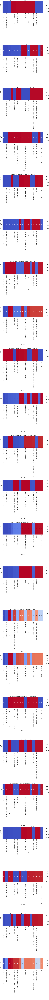

In [ ]:
#Ahora vemos solo las 15 correlaciones más altas de los indicadores socioeconómicos, respecto de la esperanza de vida por país
#Quitamos variebles "repetidas"
import seaborn as sns
import matplotlib.pyplot as plt

# Supongamos que 'correlaciones' es tu DataFrame con las correlaciones

# Obtiene la lista de países únicos en el DataFrame de correlaciones
paises = correlaciones_df['País'].unique()

# Define el tamaño de la figura para cada mapa de calor
fig, axes = plt.subplots(len(paises), figsize=(14, 10 * len(paises)))  # Aumenta el espacio en el eje Y

# Itera a través de cada país y crea un mapa de calor
for i, pais in enumerate(paises):
    # Filtra el DataFrame para el país actual
    correlaciones_pais = correlaciones_df[correlaciones_df['País'] == pais]

    # Elimina la columna 'País' y 'Life expectancy at birth, total (years)'
    correlaciones_pais = correlaciones_pais.drop(columns=['País', 'Life expectancy at birth, total (years)'])

    # Encuentra las 15 correlaciones más altas para el país actual
    top_correlaciones = correlaciones_pais.abs().mean().nlargest(15)

    # Filtra el DataFrame para incluir solo las correlaciones más altas
    correlaciones_top = correlaciones_pais[top_correlaciones.index]

    # Crea el mapa de calor para el país actual en el subplot correspondiente
    ax = axes[i]

    # Aumenta el tamaño de la fuente en los números de correlación
    sns.heatmap(correlaciones_top, ax=ax, annot=True, cmap='coolwarm', fmt=".2f", annot_kws={"size": 8})

    ax.set_title(f'Correlaciones más altas de indicadores con la Esperanza de Vida en {pais}')
    ax.set_xlabel('Indicadores')
    ax.set_ylabel('Esperanza de Vida (E. V)')

# Ajusta el espaciado entre subplots
plt.tight_layout()

# Aumenta el espacio en el eje Y
plt.subplots_adjust(left=0.15)  # Puedes ajustar el valor según tus necesidades

# Muestra los mapas de calor para cada país
plt.show()


In [ ]:
#Vemos la misma informacion de los 15 indicadores que mas correlacionan con la Esperanza de Vida, por países
#En una tabla
# Supongamos que 'correlaciones' es tu DataFrame con las correlaciones
# Obtiene la lista de países únicos en el DataFrame de correlaciones
paises = correlaciones_df['País'].unique()

# Crea una lista de diccionarios para almacenar la información de las 15 correlaciones más altas
data = []

# Itera a través de cada país
for pais in paises:
    # Filtra el DataFrame para el país actual
    correlaciones_pais = correlaciones_df[correlaciones_df['País'] == pais]
    
    # Elimina la columna 'País' y 'Life expectancy at birth, total (years)'
    correlaciones_pais = correlaciones_pais.drop(columns=['País', 'Life expectancy at birth, total (years)'])
    
    # Encuentra las 15 correlaciones más altas para el país actual
    top_correlaciones = correlaciones_pais.abs().mean().nlargest(15)
    
    # Agrega las correlaciones más altas a la lista de diccionarios
    for indicador, correlacion in top_correlaciones.items():
        data.append({'País': pais, 'Indicadores': indicador, 'Correlaciones': correlacion})

# Crea el DataFrame a partir de la lista de diccionarios
correlaciones_top_df = pd.DataFrame(data)

# Muestra la tabla de correlaciones
print(correlaciones_top_df)


              País                                        Indicadores  \
0        Argentina  Mortality rate, adult, female (per 1,000 femal...   
1        Argentina  Mortality rate, adult, male (per 1,000 male ad...   
2        Argentina             Prevalence of overweight (% of adults)   
3        Argentina           Rural population (% of total population)   
4        Argentina                 Population ages 80 and above, male   
..             ...                                                ...   
340  Venezuela, RB                                  Population, total   
341  Venezuela, RB                                   Urban population   
342  Venezuela, RB           Rural population (% of total population)   
343  Venezuela, RB                          Number of neonatal deaths   
344  Venezuela, RB         Pregnant women receiving prenatal care (%)   

     Correlaciones  
0         0.987368  
1         0.981667  
2         0.959985  
3         0.940552  
4         0.935094

In [ ]:
correlaciones_top_df.head(500)

,País,Indicadores,Correlaciones
0,Argentina,"Mortality rate, adult, female (per 1,000 femal...",0.987368
1,Argentina,"Mortality rate, adult, male (per 1,000 male ad...",0.981667
2,Argentina,Prevalence of overweight (% of adults),0.959985
3,Argentina,Rural population (% of total population),0.940552
4,Argentina,"Population ages 80 and above, male",0.935094
...,...,...,...
340,"Venezuela, RB","Population, total",0.291700
341,"Venezuela, RB",Urban population,0.288920
342,"Venezuela, RB",Rural population (% of total population),0.287870
343,"Venezuela, RB",Number of neonatal deaths,0.270501


In [ ]:


# Exporta las correlaciones a un archivo CSV
correlaciones_top_df.to_csv('correlaciones_top.csv', index=False)

Posibles KPI

In [ ]:
#Si definimos producto. Informe para gobierno publico de un país
Relaciones más destacadas - Argentina Pais de ingreso Medio
-Cuanto más aumenta la tasa de mortalidad, la esperanza de vida baja con nuna correlación de casi unoo.
Por lo que se recomienda gastar en politicas qeu disminuyan la tasas de mortalidad
Si se fomentn políticas que reduzcan la tasa  de mortalidad en 1%, la Esperanza de vida pordrá crecer casi 1% (0.98%)
Si se focalizan las politicas en reducir la obeidad de la población, la esperanza de vida aumenta en casi 1%
Aumentar el PBI per capita, Si aumenta el PBI per capita, la Esperanza de Vida aumenta en 0,93%
Si disminuye la población rural y se urbaniza la población con aceso a servicios públicos básicos, aumenta la calidad de vidam y la espeanda de vida en 
Si el gobierno aumenta el presupuesto en salud el 1% del PBI, aumenta la Esperanza de Vida en 0,.94%

SyntaxError: invalid syntax (915287686.py, line 2)

In [ ]:
Para definir kpi, algo posible es estudiar las tasas de creiciento de estos indicadores clave y decimos que:
Si la tasa de mortalidad disminuye en x% en 10 años, la esperanza de vida puede aumentar en x años.  
El objetivo es ver si las politicas logrna disminuir eficacmmente la tasa de mortalidad en x% en 10 años   